<a href="https://colab.research.google.com/github/PabloMurer/Data-Science-III/blob/main/Data_Science_III_FINAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **E-COMMERCE DE BRASIL**

LINK DE ACCESO A GITHUB: https://github.com/PabloMurer/Data-Science-III/blob/main/Data_Science_III_FINAL.ipynb

## 0. INTRODUCCION

El presente trabajo se centra en el analisis de un conjunto de Datos Público de Comercio Electrónico (E-Commerce) Brasileño por Olist.

El conjunto de datos contiene información de 100 mil pedidos de 2016 a 2018 realizados en múltiples mercados en Brasil.

Sus características permiten analizar un pedido desde múltiples dimensiones: desde el estado del pedido, precio, pago y desempeño del envío hasta la ubicación del cliente, atributos del producto y, finalmente, reseñas escritas por los clientes.

### 0.1 ¿Que es Olist?

Olist, una destacada startup brasileña fundada en 2015.

Esta plataforma actua como un intermediario eficiente, conectando pequeños y medianos comerciantes con los principales marketplaces (como ser Mercado Libre o Amazon) y canales de venta en línea.

Su modelo de negocio innovador no solo facilita la digitalización de las operaciones, sino que también ofrece soluciones de logística, marketing y financiamiento.

Con una presencia cada vez más sólida en el mercado, Olist ha demostrado su capacidad para empoderar a los negocios locales y ayudarles a competir en un entorno cada vez más digitalizado y competitivo.

A continuacion se deja un Link con mayor informacion.

Link: https://emprenderte.co/startups/startup-olist/


### 0.2 Contexto

Estos son datos comerciales reales, han sido anonimizados y las referencias a las empresas y socios en el texto de la reseña han sido reemplazadas con datos ficticios.  

Después de que un cliente compra el producto en la Tienda Olist, un vendedor recibe una notificación para cumplir con ese pedido.

Una vez que el cliente recibe el producto, o cuando la fecha estimada de entrega llega, el cliente recibe una encuesta de satisfacción por correo electrónico donde puede dar una calificación sobre la experiencia de compra y escribir algunos comentarios.

Un pedido puede tener múltiples artículos. Cada artículo puede ser cumplido por un vendedor distinto.

Todos los textos que identifican tiendas y socios fueron reemplazados por valores ficticios.

## 1. OBJETIVOS

El objetivo principal de este proyecto predecir la naturaleza de los comentarios realizados por los usuarios, identificandolos como positivos, negativos o neutros.

Por otro lado, entender cuales son las expresiones y palabras que aparecen con mas frecuencia y realizar una exploracion de los comentarios para determinar ciertas conclusiones, como ser, longitudes promedios de comentarios, entre otros.

Para ello, se propone aplicar 3 modelos de machine learning, comparando luego el resultado de los mismos (Regresion logistica, Xgboost y SVM).

Por ultimo, se propone aplicar un modelo de red neuronal para predecir la calificacion de los usuarios (o grado de satisfaccion).

## 2. LECTURA INICIAL DE DATOS

### 2.1 Importacion librerias y datasets

In [1]:
# Importar librerías
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline
sns.set(style="whitegrid")

import warnings
warnings.filterwarnings('ignore')

In [2]:
# Configuramos el entorno de Python en Google Colab
from google.colab import drive
import os

drive.mount("/content/drive")
print(os.getcwd())

os.chdir("/content/drive/My Drive/Data science III/datasets")
print(os.getcwd())



Mounted at /content/drive
/content
/content/drive/My Drive/Data science III/datasets


In [3]:
# Lectura de los 9 datasets que conforman la base bajo analisis.

# Read the customers dataset
df_customers = pd.read_csv('olist_customers_dataset.csv')

# Read the location dataset
df_location = pd.read_csv('olist_geolocation_dataset.csv')

# Read the items dataset
df_oitems = pd.read_csv('olist_order_items_dataset.csv')

# Read the payments dataset
df_opayments = pd.read_csv('olist_order_payments_dataset.csv')

# Read the riviews dataset
df_oreviews = pd.read_csv('olist_order_reviews_dataset.csv')

# Read the orders dataset
df_orders = pd.read_csv('olist_orders_dataset.csv')

# Read the products dataset
df_products = pd.read_csv('olist_products_dataset.csv')

# Read the sellers dataset
df_sellers = pd.read_csv('olist_sellers_dataset.csv')

# Read the product category dataset
df_pcategory = pd.read_csv('product_category_name_translation.csv')

### 2.2 Schema: Como se comunican los diferentes datasets

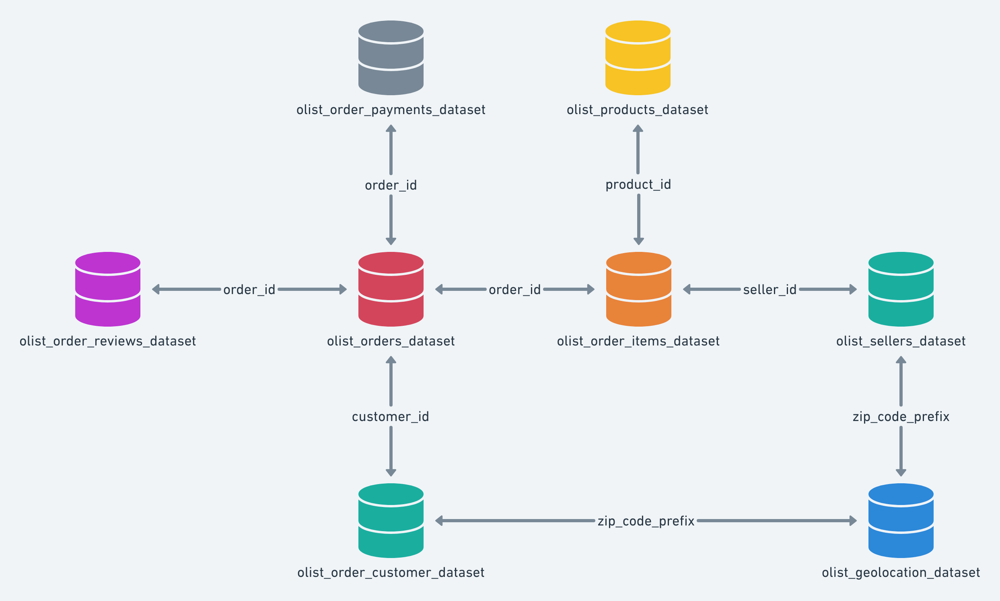

## 3. INSPECCION INICIAL DE DATAFRAME DF

#### 3.1 Fusion de datasets

In [4]:
# Fusionamos los diferentes datasets para conformar uno solo

df = df_orders.merge(df_oitems, on='order_id', how='inner')
df = df.merge(df_opayments, on='order_id', how='inner', validate='m:m')
df = df.merge(df_oreviews, on='order_id', how='inner')
df = df.merge(df_products, on='product_id', how='inner')
df = df.merge(df_customers, on='customer_id', how='inner')
df = df.merge(df_sellers, on='seller_id', how='inner')

In [5]:
datasets = {
    'df_customers': df_customers,
    'df_location': df_location,
    'df_oitems': df_oitems,
    'df_opayments': df_opayments,
    'df_oreviews': df_oreviews,
    'df_orders': df_orders,
    'df_products': df_products,
    'df_sellers': df_sellers,
    'df_pcategory': df_pcategory,
    'df': df # Include the merged dataframe as well
}

summary_data = []

for name, dataset in datasets.items():
    n_rows, n_cols = dataset.shape
    null_amount = dataset.isnull().sum().sum()
    null_columns_info = dataset.isnull().sum()
    qty_null_columns = sum(null_columns_info > 0)
    null_columns = null_columns_info[null_columns_info > 0].index.tolist()

    summary_data.append({
        'dataset': name,
        'n_rows': n_rows,
        'n_cols': n_cols,
        'null_amount': null_amount,
        'qty_null_columns': qty_null_columns,
        'null_columns': null_columns
    })

summary_df = pd.DataFrame(summary_data)


# Adjust display options to show the full content of the 'null_columns'
pd.set_option('display.max_colwidth', None)

# Display the summary dataframe again
display(summary_df)

,dataset,n_rows,n_cols,null_amount,qty_null_columns,null_columns
0,df_customers,99441,5,0,0,[]
1,df_location,1000163,5,0,0,[]
2,df_oitems,112650,7,0,0,[]
3,df_opayments,103886,5,0,0,[]
4,df_oreviews,100000,7,146532,2,"[review_comment_title, review_comment_message]"
5,df_orders,99441,8,4908,3,"[order_approved_at, order_delivered_carrier_date, order_delivered_customer_date]"
6,df_products,32951,9,2448,8,"[product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm]"
7,df_sellers,3095,4,0,0,[]
8,df_pcategory,71,2,0,0,[]
9,df,118315,39,182649,13,"[order_approved_at, order_delivered_carrier_date, order_delivered_customer_date, review_comment_title, review_comment_message, product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm]"


#### 3.2 Descripcion de variables:

* **V0- ORDER_ID:** Identificacion univoca de cada pedido realizado. Es de ***tipo object***.

* **V1- CUSTOMER_ID:** Identificacion univoca de cada cliente registrado. Es de ***tipo object***.

* **V2- ORDER_STATUS:** Describe el status de cada pedido realizado. Es de ***tipo object*** y tiene 7 posibles valores:
    1. 'delivered'   = entregado
    2. 'invoiced'    = facturado
    3. 'shipped'     = enviado
    4. 'processing'  = procesado  
    5. 'canceled'    = cancelado
    6. 'unavailable' = no disponible
    7. 'approved'    = aprobado

* **V3- ORDER_PURCHASE_TIMESTAMP:** Fecha de emision del pedido. Es de ***tipo object***. El formato es de tipo "YYYY-MM-DD HH:MM:SS".

* **V4- ORDER_APPROVED_AT:** Fecha de aprobacion del pedido. Es de ***tipo object***. El formato es de tipo "YYYY-MM-DD HH:MM:SS".

* **V5- ORDER_DELIVERED_CARRIER_DATE:** Fecha de entrega del pedido al transportista. Es de ***tipo object***. El formato es de tipo "YYYY-MM-DD HH:MM:SS".

* **V6-ORDER_DELIVERED_CUSTOMER_DATE:**  Fecha de entrega del pedido al cliente. Es de ***tipo object***. El formato es de tipo "YYYY-MM-DD HH:MM:SS".

* **V7-ORDER_ESTIMATED_DELIVERY_DATE:**  Fecha estimada de entrega del pedido al cliente. Es de ***tipo object***. El formato es de tipo "YYYY-MM-DD HH:MM:SS".

* **V8-ORDER_ITEM_ID:**  ID del item de un pedido (considerando un pedido puede contener varios productos/items). Es de ***tipo integer***.

* **V9-PRODUCT_ID:**  ID de un producto. Es de ***tipo object***.

* **V10-SELLER_ID:**  ID del vendedor registrado. Es de ***tipo object***.

* **V11-SHIPPING_LIMIT_DATE:**  Fecha maxima de entrega del pedido. Es de ***tipo object***. El formato es de tipo "YYYY-MM-DD HH:MM:SS".

* **V12-PRICE:**  Precio total de un item en particular. Es de ***tipo float***.

* **V13-FREIGHT_VALUE:**  Precio del transporte de un item en particular. Es de ***tipo float***.

* **V14-PAYMENT_SEQUENTIAL:**  Orden en que se realiza el pago de un pedido. Es de ***tipo float***.

* **V15-PAYMENT_TYPE:**  Orden en que se realiza el pago de un pedido. Es de ***tipo float***.

    1. 'credit_card'
    2. 'voucher'     
    3. 'boleto'     
    4. 'debit_card'

* **V16-PAYMENT_INSTALLMENTS:**  Cuotas del pago a realizarse. Es de ***tipo integer***.  

* **V17-PAYMENT_VALUE:**  Monto del pago realizado. Es de ***tipo float***.

* **V18-REVIEW_ID:**  ID de la reseña del cliente. Es de ***tipo object***.

* **V19-REVIEW_SCORE:**  Puntuacion de la reseña del cliente. Es de ***tipo integer***.

* **V20-REVIEW_COMMENT_TITTLE:**  Titulo de la reseña del cliente. Es de ***tipo object***.

* **V21-REVIEW_COMMENT_MESSAGE:**  Reseña del cliente. Es de ***tipo object***.

Nota: Si bien la variable V20 (Titulo de la reseña) puede ser nulo, no implica que la reseña (comentario o variable V21) tambien sea nula.

* **V22-REVIEW_CREATION_DATE:**  Fecha de la reseña. Es de ***tipo object***. El formato es de tipo "YYYY-MM-DD HH:MM:SS".

* **V23-REVIEW_ANSWER_TIMESTAMP:**  Fecha de la respuesta a la reseña. Es de ***tipo object***. El formato es de tipo "YYYY-MM-DD HH:MM:SS".

* **V24-PRODUCT_CATEGORY_NAME:**  Nombre de la categoria a la que pertenece el producto. Es de ***tipo object***. Existen 73 categorias diferentes en este dataset.

* **V25-PRODUCT_NAME_LENGHT:**  Longitud del nombre del producto. Es de ***tipo float***.

* **V26-PRODUCT_DESCRIPTION_LENGHT:**  Longitud de la descripcion del producto. Es de ***tipo float***.

* **V27-PRODUCT_PHOTOS_QTY:**  Cantidad de fotos del producto. Es de ***tipo float***.

* **V28-PRODUCT_WEIGHT_G:**  Peso en gramos del producto. Es de ***tipo float***.

* **V29-PRODUCT_LENGTH_CM:**  Longitud en centimetros del producto. Es de ***tipo float***.

* **V30-PRODUCT_HEIGHT_CM:**  Altura en centimetros del producto. Es de ***tipo float***.

* **V31-PRODUCT_WIDTH_CM:**  Ancho en centimetros del producto. Es de ***tipo float***.

* **V32-CUSTOMER_UNIQUE_ID:**  ID de cada cliente registrado. Es de ***tipo object***.

* **V33-CUSTOMER_ZIP_CODE_PREFIX:**  Codigo postal de cada cliente. Es de ***tipo integer***.

* **V34-CUSTOMER_CITY:**  Ciudad de cada cliente. Es de ***tipo object***.

* **V35-CUSTOMER_STATE:**  Estado de cada cliente. Es de ***tipo object***.

* **V36-SELLER_ZIP_CODE_PREFIX:**  Codigo postal de cada vendedor. Es de ***tipo integer***.

* **V37-SELLER_CITY:**  Ciudad de cada vendedor. Es de ***tipo object***.

* **V38-CUSTOMER_STATE:**  Estado de cada vendedor. Es de ***tipo object***.





#### 3.3 Dimensiones, tipo de datos y estadisticas básicas:

In [12]:
# imprimimos primeras 10 filas del dataframe df ajustando todas las columnas en una sola hoja y seleccionando
# las primeras 10 filas/registros.

# Nota: Si usaramos la sentencia df.tail(10) mostraria las ultimas 10 filas.
# Si usaramos df.sample(10) mostraria 10 registros aleatoriamente.

pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)

df.head(10)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,seller_zip_code_prefix,seller_city,seller_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,1,credit_card,1,18.12,a54f0611adc9ed256b57ede6b6eb5114,4,NaN,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",2017-10-11 00:00:00,2017-10-12 03:43:48,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,9350,maua,SP
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,3,voucher,1,2.00,a54f0611adc9ed256b57ede6b6eb5114,4,NaN,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",2017-10-11 00:00:00,2017-10-12 03:43:48,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,9350,maua,SP
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,2,voucher,1,18.59,a54f0611adc9ed256b57ede6b6eb5114,4,NaN,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",2017-10-11 00:00:00,2017-10-12 03:43:48,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,9350,maua,SP
3,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,1,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,1,boleto,1,141.46,8d5266042046a06655c8db133d120ba5,4,Muito boa a loja,Muito bom o produto.,2018-08-08 00:00:00,2018-08-08 18:37:50,perfumaria,29.0,178.0,1.0,400.0,19.0,13.0,19.0,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,31570,belo horizonte,SP
4,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,1,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,1,credit_card,3,179.12,e73b67b67587f7644d5bd1a52deb1b01,5,NaN,NaN,2018-08-18 00:00:00,2018-08-22 19:07:58,automotivo,46.0,232.0,1.0,420.0,24.0,19.0,21.0,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,14840,guariba,SP
5,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,1,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 1

In [ ]:
df.shape

(118315, 39)

Conclusion: El dataframe finalmente conformado tiene 39 columnas y 118.315 filas

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118315 entries, 0 to 118314
Data columns (total 39 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       118315 non-null  object 
 1   customer_id                    118315 non-null  object 
 2   order_status                   118315 non-null  object 
 3   order_purchase_timestamp       118315 non-null  object 
 4   order_approved_at              118300 non-null  object 
 5   order_delivered_carrier_date   117061 non-null  object 
 6   order_delivered_customer_date  115727 non-null  object 
 7   order_estimated_delivery_date  118315 non-null  object 
 8   order_item_id                  118315 non-null  int64  
 9   product_id                     118315 non-null  object 
 10  seller_id                      118315 non-null  object 
 11  shipping_limit_date            118315 non-null  object 
 12  price                         

In [14]:
# Generamos un describe para variables numericas, colocando los numero con 2 decimales
# (tipo float en lugar de numeracion cientifica).

# Ademas, transponemos la matriz, colocando en las columnas los valores del analisis y en las filas las variables
# Esto ultimo para que sea legible y entre en un solo "renglon"

pd.options.display.float_format = '{:.2f}'.format
print(df.describe().T.to_string())

                               count     mean      std     min      25%      50%      75%      max
order_item_id              118315.00     1.20     0.70    1.00     1.00     1.00     1.00    21.00
price                      118315.00   120.65   184.11    0.85    39.90    74.90   134.90  6735.00
freight_value              118315.00    20.03    15.84    0.00    13.08    16.28    21.18   409.68
payment_sequential         118315.00     1.09     0.73    1.00     1.00     1.00     1.00    29.00
payment_installments       118315.00     2.94     2.78    0.00     1.00     2.00     4.00    24.00
payment_value              118315.00   172.58   267.10    0.00    60.85   108.20   189.26 13664.08
review_score               118315.00     4.01     1.40    1.00     3.00     5.00     5.00     5.00
product_name_lenght        116606.00    48.77    10.03    5.00    42.00    52.00    57.00    76.00
product_description_lenght 116606.00   785.94   652.58    4.00   346.00   600.00   983.00  3992.00
product_ph

Principales observaciones:

1- order_item_id: Se observa que el pedido que mas items contiene tiene un total de 21 items, mientras que el minimo contiene 1 solo item. Considerando la media es 1,20 podemos inferir que la mayoria tiene 1 solo item.

2- Como caracteristicas de los productos, es posible analizar los pesos y dimensiones. Los items van desde practicamente peso nulo hasta 40,4 kg. La altura va desde 2 cm a 105 cm. El ancho va desde 6 cm hasta 118 cm, mientras que el largo va desde 7 cm hasta 105 cm.

3- Una caracteristica muy importantes es la evaluacion del servicio. En promedio esta en 4.01 en una escala de 1 a 5. Se observa que hay evaluaciones desde 1 a 5, pero el promedio induce que la mayoria ha evaluado correctamente el servicio.

4- La cantidad de cuotas induce que el promedio esta en torno a 2,94 casi 3 pagos, con un maximo en 24 cuotas.

In [15]:
# Generamos a continuacion un describe para las variables categoricas de df

pd.options.display.float_format = '{:.2f}'.format
print(df.describe(include='object').T.to_string())

                                count unique                               top    freq
order_id                       118315  98665  895ab968e7bb0d5659d16cd74cd1650c      63
customer_id                    118315  98665  270c23a11d024a44c896d1894b261a83      63
order_status                   118315      7                         delivered  115728
order_purchase_timestamp       118315  98111               2017-08-08 20:26:31      63
order_approved_at              118300  90173               2017-08-08 20:43:31      63
order_delivered_carrier_date   117061  81016               2017-08-10 11:58:14      63
order_delivered_customer_date  115727  95663               2017-08-14 12:46:18      63
order_estimated_delivery_date  118315    449               2017-12-20 00:00:00     656
product_id                     118315  32951  aca2eb7d00ea1a7b8ebd4e68314663af     536
seller_id                      118315   3095  4a3ca9315b744ce9f8e9374361493884    2155
shipping_limit_date            118315  9331

In [16]:
# Reflejamos a continuacion por columna/variable la cantidad de datos nulos y datos unicos.
# A su vez, se calcula y muestra el % de datos nulos (sobre el total de datos)

print(pd.DataFrame({
    'datos_nulos': df.isnull().sum(),
    '%_nulos': (df.isnull().sum() / len(df) * 100).map('{:.2f}%'.format),
    'datos_unicos': df.nunique(),
}))

                               datos_nulos %_nulos  datos_unicos
order_id                                 0   0.00%         98665
customer_id                              0   0.00%         98665
order_status                             0   0.00%             7
order_purchase_timestamp                 0   0.00%         98111
order_approved_at                       15   0.01%         90173
order_delivered_carrier_date          1254   1.06%         81016
order_delivered_customer_date         2588   2.19%         95663
order_estimated_delivery_date            0   0.00%           449
order_item_id                            0   0.00%            21
product_id                               0   0.00%         32951
seller_id                                0   0.00%          3095
shipping_limit_date                      0   0.00%         93317
price                                    0   0.00%          5968
freight_value                            0   0.00%          6999
payment_sequential       

Es posible observar que el valor de nulos es practicamente despreciable en la mayoria de las variables.

Donde mas impacto de datos nulos tenemos es en el titulo de las reseñas (practicamente un 88% es nulo). Sin embargo, los comentarios tienen un 57% de nulos, con lo cual, existen muchos clientes que no colocan un titulo pero si un comentario.

Por otro lado, la calificacion del servicio no tiene nulos, lo cual da a entender todos evaluan el servicio, pero el 57% no coloca comentarios ampliando el motivo de la calificacion.

## 4. ANALISIS EXPLORATORIO DE DATOS

#### 4.1 Principales categorias de productos

In [17]:
# Calculamos cantidad de categorias unicas
num_unique_categories = df['product_category_name'].nunique()

# Calculamos el número de pedidos únicos por categoría de producto
orders_per_category = df.groupby('product_category_name')['order_id'].nunique()

# Convertimos la serie en un dataframe para una manipulación más fácil
orders_per_category_df = orders_per_category.reset_index()
orders_per_category_df.columns = ['product_category_name', 'order_count']

# Calculamos el numero total de ordenes
total_orders = df['order_id'].nunique()

# Calculamos el % del total de ordenes por categoria de producto
orders_per_category_df['percentage_of_total_orders'] = (orders_per_category_df['order_count'] / total_orders) * 100

# Ordenamos el dataframe por el conteo de pedidos en orden descendente
orders_per_category_df = orders_per_category_df.sort_values(by='order_count', ascending=False)

# Calculamos el porcentaje acumulado por categorias de productos
orders_per_category_df['cumulative_percentage'] = orders_per_category_df['percentage_of_total_orders'].cumsum()

# Filtramos las categorias de productos que representan el 80% del total de pedidos
top_categories = orders_per_category_df[orders_per_category_df['cumulative_percentage'] <= 80]

# Agrega la siguiente categoría si se supera el umbral del 80% dentro de esa categoría
# Esto es para los casos donde el corte del 80% está dentro de una categoría
if orders_per_category_df['cumulative_percentage'].iloc[len(top_categories) -1] < 80 and len(top_categories) < len(orders_per_category_df):
    top_categories = pd.concat([top_categories, orders_per_category_df.iloc[[len(top_categories)]]])


# Imprimimos el número de categorías totales y aquellas que conforman el 80% de pedidos totales
print(f"Número de categorías totales:", (num_unique_categories))
print(f"\nNúmero de categorías que representan aproximadamente el 80% de los pedidos: {len(top_categories)}")
print("\nCategorías que representan aproximadamente el 80 % de los pedidos:")
display(top_categories[['product_category_name', 'order_count', 'percentage_of_total_orders', 'cumulative_percentage']])

Número de categorías totales: 73

Número de categorías que representan aproximadamente el 80% de los pedidos: 16

Categorías que representan aproximadamente el 80 % de los pedidos:


,product_category_name,order_count,percentage_of_total_orders,cumulative_percentage
13,cama_mesa_banho,9417,9.54,9.54
11,beleza_saude,8835,8.95,18.50
32,esporte_lazer,7720,7.82,26.32
44,informatica_acessorios,6689,6.78,33.10
54,moveis_decoracao,6449,6.54,39.64
72,utilidades_domesticas,5884,5.96,45.60
66,relogios_presentes,5624,5.70,51.30
70,telefonia,4199,4.26,55.56
8,automotivo,3897,3.95,59.51
12,brinquedos,3886,3.94,63.45


Queda evidenciado que solo 16 categorias de productos representan el 80% del total de pedidos (sobre un total de 73 categorias).

#### 4.2 Analisis de clientes y vendedores

In [18]:
# Contamos cantidad de clientes y vendedores unicos
num_unique_customers = df['customer_unique_id'].nunique()
num_unique_sellers = df['seller_id'].nunique()
num_unique_orders = df['order_id'].nunique()

print(f"Cantidad de clientes registrados: {num_unique_customers}")
print(f"Cantidad de vendedores registrados: {num_unique_sellers}")
print(f"Cantidad de pedidos registrados: {num_unique_orders}")

# Calculamos cantidad de pedidos por cliente
purchases_per_customer = df.groupby('customer_unique_id')['order_id'].nunique()

print("\nPedidos por cliente:")
print(f"  Cantidad de pedidos promedio: {purchases_per_customer.mean():.2f}")
print(f"  Cantidad de pedidos maxima: {purchases_per_customer.max()}")
print(f"  Cantidad de pedidos minima: {purchases_per_customer.min()}")

# Calculamos cantidad de pedidos por vendedor
purchases_per_seller = df.groupby('seller_id')['order_id'].nunique()

print("\nPedidos por vendedor:")
print(f"  Cantidad de pedidos promedio: {purchases_per_seller.mean():.2f}")
print(f"  Cantidad de pedidos maxima: {purchases_per_seller.max()}")
print(f"  Cantidad de pedidos minima: {purchases_per_seller.min()}")

Cantidad de clientes registrados: 95419
Cantidad de vendedores registrados: 3095
Cantidad de pedidos registrados: 98665

Pedidos por cliente:
  Cantidad de pedidos promedio: 1.03
  Cantidad de pedidos maxima: 16
  Cantidad de pedidos minima: 1

Pedidos por vendedor:
  Cantidad de pedidos promedio: 32.31
  Cantidad de pedidos maxima: 1854
  Cantidad de pedidos minima: 1


Segun los datos del dataframe, en promedio cada cliente emitio un pedido (con un minimo de 1 pedido y un maximo de 16).

En cambio, en promedio cada vendedor atendio 32 pedidos, con un maximo de 1854 pedidos y un minimo de un unico pedido.

In [ ]:
import folium

# Fusionamos los datos de los vendedores (df_sellers) con los datos de geolocalización (df_location)
# basándonos en los códigos postales para obtener la latitud y longitud de cada vendedor.

# Es decir, fusionamos los dataframes de vendedores y geolocalización para obtener las coordenadas geográficas de cada vendedor
# en función de sus códigos postales.

df_sellers_geo = pd.merge(df_sellers, df_location, left_on='seller_zip_code_prefix', right_on='geolocation_zip_code_prefix', how='left')

df_sellers_geo = df_sellers_geo.drop_duplicates(subset=['seller_zip_code_prefix'])

seller_locations_agg = df_sellers_geo.groupby(['geolocation_lat', 'geolocation_lng']).size().reset_index(name='seller_count')

# Creamos mapa centrado en Brasil
m = folium.Map(location=[-14.235004, -51.92528], zoom_start=4)

# Iteramos a través de las ubicaciones de vendedores agregadas y añade marcadores circulares
for index, row in seller_locations_agg.iterrows():
    folium.CircleMarker(
        location=[row['geolocation_lat'], row['geolocation_lng']],
        radius=np.sqrt(row['seller_count']) * 2,  # Ajustar el radio según la cantidad de vendedores
        popup=f"Sellers: {row['seller_count']}",
        tooltip=f"Lat: {row['geolocation_lat']:.2f}, Lng: {row['geolocation_lng']:.2f}, Sellers: {row['seller_count']}",
        color='blue',
        fill=True,
        fill_color='blue'
    ).add_to(m)

# Mostramos el mapa resultante
display(m)

In [ ]:
# Merge customer data (df_customers) with geolocation data (df_location) based on zip codes
df_customers_geo = pd.merge(df_customers, df_location, left_on='customer_zip_code_prefix', right_on='geolocation_zip_code_prefix', how='left')

# Drop duplicate zip code entries in geolocation to have one representative location per zip code
df_customers_geo = df_customers_geo.drop_duplicates(subset=['customer_zip_code_prefix'])

# Aggregate customer counts by geographical coordinates
customer_locations_agg = df_customers_geo.groupby(['geolocation_lat', 'geolocation_lng']).size().reset_index(name='customer_count')

# Create a map centered on Brazil
m_customers = folium.Map(location=[-14.235004, -51.92528], zoom_start=4)

# Iterate through the aggregated customer locations and add circle markers
for index, row in customer_locations_agg.iterrows():
    folium.CircleMarker(
        location=[row['geolocation_lat'], row['geolocation_lng']],
        radius=np.sqrt(row['customer_count']) * 0.5,  # Adjust radius according to customer count
        popup=f"Customers: {row['customer_count']}",
        tooltip=f"Lat: {row['geolocation_lat']:.2f}, Lng: {row['geolocation_lng']:.2f}, Customers: {row['customer_count']}",
        color='red',  # Using red for customer markers
        fill=True,
        fill_color='red'
    ).add_to(m_customers)

# Display the map resulting from the customer data
display(m_customers)

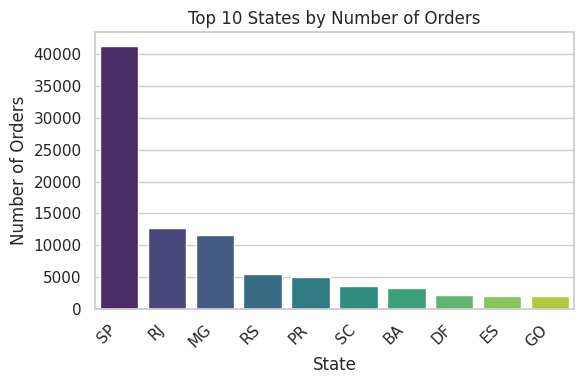

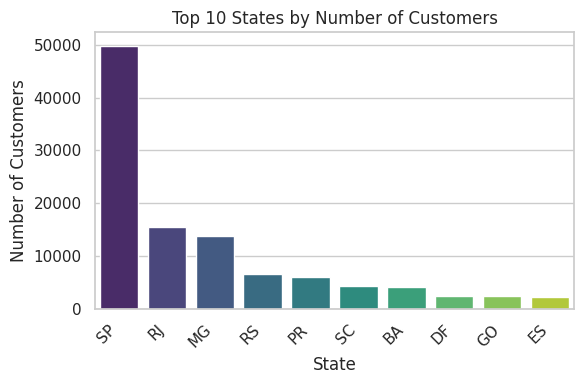

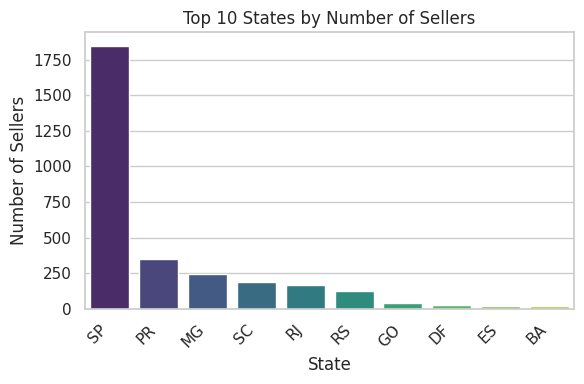

In [19]:
import matplotlib.pyplot as plt
import seaborn as sns

# Top 10 states by number of orders
orders_by_state = df.groupby('customer_state')['order_id'].nunique().sort_values(ascending=False).head(10)

plt.figure(figsize=(6, 4)) # Further adjusted figure size
sns.barplot(x=orders_by_state.index, y=orders_by_state.values, palette='viridis')
plt.title('Top 10 States by Number of Orders')
plt.xlabel('State')
plt.ylabel('Number of Orders')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Top 10 states by number of customers
customers_by_state = df['customer_state'].value_counts().sort_values(ascending=False).head(10)

plt.figure(figsize=(6, 4)) # Further adjusted figure size
sns.barplot(x=customers_by_state.index, y=customers_by_state.values, palette='viridis')
plt.title('Top 10 States by Number of Customers')
plt.xlabel('State')
plt.ylabel('Number of Customers')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Top 10 states by number of sellers
sellers_by_state = df_sellers['seller_state'].value_counts().sort_values(ascending=False).head(10)

plt.figure(figsize=(6, 4)) # Further adjusted figure size
sns.barplot(x=sellers_by_state.index, y=sellers_by_state.values, palette='viridis')
plt.title('Top 10 States by Number of Sellers')
plt.xlabel('State')
plt.ylabel('Number of Sellers')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

Queda evidenciado que los clientes y vendedores estan concentrados principalmente en la zona sur de Brasil, especificamente, San Pablo. Esta concentracion se evidencia mucho mas en los vendedores que en los clientes.

#### 4.2 Status pedidos y tiempos promedios

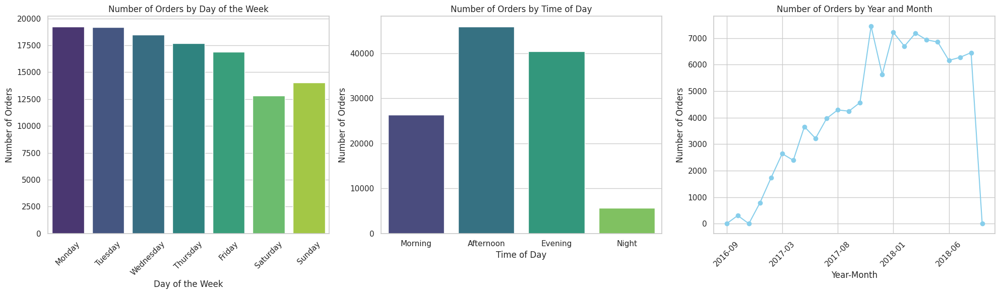

In [20]:
# Convert timestamp column to datetime
df['order_purchase_timestamp'] = pd.to_datetime(df['order_purchase_timestamp'])

# Analyze Orders by Day of the Week
df['day_of_week'] = df['order_purchase_timestamp'].dt.day_name()
orders_by_day = df['day_of_week'].value_counts().reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Analyze Orders by Time of Day
def get_time_of_day(hour):
    if 0 <= hour < 6:
        return 'Night'
    elif 6 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 18:
        return 'Afternoon'
    else:
        return 'Evening' # Changed from Night to Evening for clarity

df['time_of_day'] = df['order_purchase_timestamp'].dt.hour.apply(get_time_of_day)
orders_by_time_of_day = df['time_of_day'].value_counts().reindex(['Morning', 'Afternoon', 'Evening', 'Night'])


# Analyze Orders by Year and Month
df['year_month'] = df['order_purchase_timestamp'].dt.to_period('M').astype(str)
orders_by_year_month = df.groupby('year_month')['order_id'].nunique()


# Display Plots
fig, axes = plt.subplots(1, 3, figsize=(20, 6)) # Adjust figure size as needed

# Plot for orders by day of the week
sns.barplot(x=orders_by_day.index, y=orders_by_day.values, ax=axes[0], palette='viridis')
axes[0].set_title('Number of Orders by Day of the Week')
axes[0].set_xlabel('Day of the Week')
axes[0].set_ylabel('Number of Orders')
axes[0].tick_params(axis='x', rotation=45)

# Plot for orders by time of day
sns.barplot(x=orders_by_time_of_day.index, y=orders_by_time_of_day.values, ax=axes[1], palette='viridis')
axes[1].set_title('Number of Orders by Time of Day')
axes[1].set_xlabel('Time of Day')
axes[1].set_ylabel('Number of Orders')

# Plot for orders by year and month
orders_by_year_month.plot(ax=axes[2], kind='line', marker='o', color='skyblue')
axes[2].set_title('Number of Orders by Year and Month')
axes[2].set_xlabel('Year-Month')
axes[2].set_ylabel('Number of Orders')
axes[2].tick_params(axis='x', rotation=45)
axes[2].grid(True)

plt.tight_layout()
plt.show()

Se evidencia en los dos primeros graficos que el numero de pedidos tiene su mayor requerimiento los dias lunes y martes de cada semana.

A su vez, existe una mayor actividad en el horario de 6 a 12 hs de cada dia, seguido por el horario de 12 a 18 hs.

Por ultimo, se evidencia en la evolucion de los pedidos desde 2016 al 2018 el exponencial crecimiento de los pedidos.

Delivery Performance Percentage:


,count
delivery_performance,
Delivered Early,92.17
Delivered Late,6.53
Delivered On Time,1.30


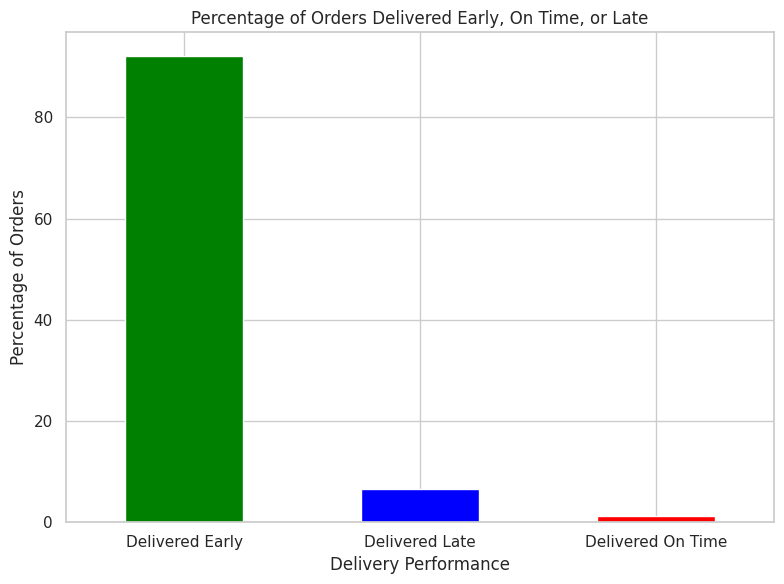

In [21]:
# Convert delivery and estimated dates to datetime
df['order_delivered_customer_date'] = pd.to_datetime(df['order_delivered_customer_date'])
df['order_estimated_delivery_date'] = pd.to_datetime(df['order_estimated_delivery_date'])

# Filter for delivered orders as only these have a delivery date
delivered_orders_df = df.dropna(subset=['order_delivered_customer_date']).copy()

# Calculate the difference between actual and estimated delivery dates
delivered_orders_df['delivery_time_difference'] = (delivered_orders_df['order_delivered_customer_date'] - delivered_orders_df['order_estimated_delivery_date']).dt.days

# Categorize delivery performance
def categorize_delivery(diff):
    if diff < 0:
        return 'Delivered Early'
    elif diff == 0:
        return 'Delivered On Time'
    else:
        return 'Delivered Late'

delivered_orders_df['delivery_performance'] = delivered_orders_df['delivery_time_difference'].apply(categorize_delivery)

# Count orders by delivery performance category
delivery_counts = delivered_orders_df['delivery_performance'].value_counts()

# Calculate percentages
total_delivered_orders = delivery_counts.sum()
delivery_percentages = (delivery_counts / total_delivered_orders) * 100

print("Delivery Performance Percentage:")
display(delivery_percentages)

# Visualize delivery performance percentages
plt.figure(figsize=(8, 6))
delivery_percentages.plot(kind='bar', color=['green', 'blue', 'red'])
plt.title('Percentage of Orders Delivered Early, On Time, or Late')
plt.xlabel('Delivery Performance')
plt.ylabel('Percentage of Orders')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

Queda claro que la mayoria de los pedidos fueron enviados antes de la fecha estimada prevista. Solo 6,53% se entregaron en forma tardia.

In [22]:
# Convert timestamps to datetime
df['order_purchase_timestamp'] = pd.to_datetime(df['order_purchase_timestamp'])
df['order_delivered_customer_date'] = pd.to_datetime(df['order_delivered_customer_date'])

# Filter for delivered orders as only these have a delivery date
delivered_orders_df = df.dropna(subset=['order_delivered_customer_date', 'order_purchase_timestamp']).copy()

# Calculate delivery time
delivered_orders_df['delivery_time'] = (delivered_orders_df['order_delivered_customer_date'] - delivered_orders_df['order_purchase_timestamp']).dt.days

# Calculate average delivery time
average_delivery_time = delivered_orders_df['delivery_time'].mean()
print(f"Average delivery time from order placement to delivery: {average_delivery_time:.2f} days")

# Calculate average delivery time per product category
average_delivery_time_by_category = delivered_orders_df.groupby('product_category_name')['delivery_time'].mean()

# Identify the category with the best (minimum) average delivery time
best_category = average_delivery_time_by_category.idxmin()
best_category_avg_time = average_delivery_time_by_category.min()
print(f"\nProduct category with the best average delivery time: '{best_category}' ({best_category_avg_time:.2f} days)")

# Identify the category with the worst (maximum) average delivery time
worst_category = average_delivery_time_by_category.idxmax()
worst_category_avg_time = average_delivery_time_by_category.max()
print(f"Product category with the worst average delivery time: '{worst_category}' ({worst_category_avg_time:.2f} days)")

# Calculate average delivery time per state
average_delivery_time_by_state = delivered_orders_df.groupby('customer_state')['delivery_time'].mean()

# Identify the state with the best (minimum) average delivery time
best_state = average_delivery_time_by_state.idxmin()
best_state_avg_time = average_delivery_time_by_state.min()
print(f"\nState with the best average delivery time: '{best_state}' ({best_state_avg_time:.2f} days)")

# Identify the state with the worst (maximum) average delivery time
worst_state = average_delivery_time_by_state.idxmax()
worst_state_avg_time = average_delivery_time_by_state.max()
print(f"State with the worst average delivery time: '{worst_state}' ({worst_state_avg_time:.2f} days)")

Average delivery time from order placement to delivery: 12.02 days

Product category with the best average delivery time: 'artes_e_artesanato' (5.29 days)
Product category with the worst average delivery time: 'moveis_escritorio' (20.51 days)

State with the best average delivery time: 'SP' (8.27 days)
State with the worst average delivery time: 'RR' (27.83 days)


El promedio de dias para entrega de un pedido ronda los 12 dias.

El estado de San Pablo es el de mejor promedio con 8,27 dias de entrega, mientras que el estado de Roraima es el de peor performance con 27,83 dias de promedio.

In [23]:
import pandas as pd

# Calculate counts and percentages for Payment Type
payment_type_counts = df['payment_type'].value_counts()
payment_type_percentages = (payment_type_counts / len(df)) * 100
payment_type_summary = pd.DataFrame({
    'Total': payment_type_counts,
    'Percentage': payment_type_percentages.map('{:.2f}%'.format)
}).sort_values(by='Total', ascending=False)

print("Payment Type Distribution:")
display(payment_type_summary)

# Calculate counts and percentages for Order Status
order_status_counts = df['order_status'].value_counts()
order_status_percentages = (order_status_counts / len(df)) * 100
order_status_summary = pd.DataFrame({
    'Total': order_status_counts,
    'Percentage': order_status_percentages.map('{:.2f}%'.format)
}).sort_values(by='Total', ascending=False)

print("\nOrder Status Distribution:")
display(order_status_summary)

Payment Type Distribution:


,Total,Percentage
payment_type,,
credit_card,87266,73.76%
boleto,23018,19.45%
voucher,6332,5.35%
debit_card,1699,1.44%



Order Status Distribution:


,Total,Percentage
order_status,,
delivered,115728,97.81%
shipped,1255,1.06%
canceled,570,0.48%
invoiced,376,0.32%
processing,376,0.32%
unavailable,7,0.01%
approved,3,0.00%


Por ultimo en nuestro analisis exploratorio propuesto, podemos evidenciar que la modalidad de pago mas utilizada es la tarjeta de credito.

A su vez, la mayoria de los pedidos fueron entregados.

#### 4.3 Nivel de satisfaccion

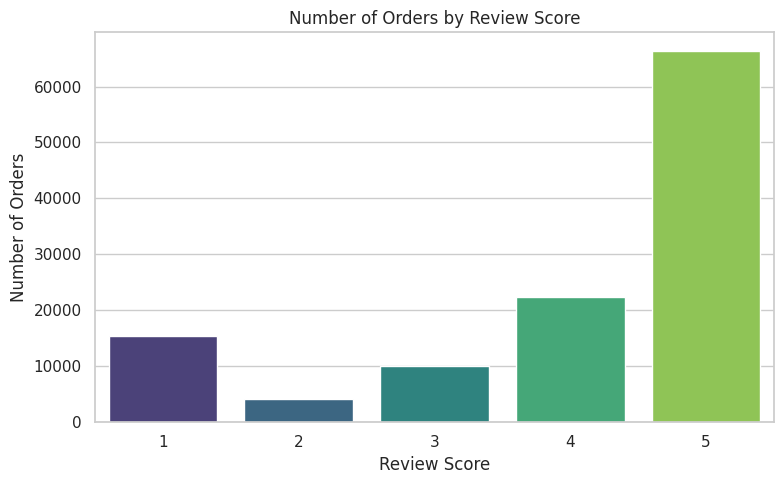

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns

# Count the number of orders for each review score
orders_by_review_score = df['review_score'].value_counts().sort_index()

# Create a bar chart
plt.figure(figsize=(8, 5))
sns.barplot(x=orders_by_review_score.index, y=orders_by_review_score.values, palette='viridis')
plt.title('Number of Orders by Review Score')
plt.xlabel('Review Score')
plt.ylabel('Number of Orders')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

Anteriormente hemos vislumbrado que el promedio de conformidad es 4. Queda claro en esta grafica que la mayoria de las evaluaciones son 4 y 5.

In [25]:
# Calculate average review score per state
average_review_score_by_state = df.groupby('customer_state')['review_score'].mean().sort_values(ascending=False)

# Convert the series to a dataframe for display
average_review_score_by_state_df = average_review_score_by_state.reset_index()
average_review_score_by_state_df.columns = ['State', 'Average Review Score']

print("Average Review Score by State (Sorted):")
display(average_review_score_by_state_df)

# Calculate overall average review score
overall_average_review_score = df['review_score'].mean()
print(f"\nOverall average review score across all states: {overall_average_review_score:.2f}")

Average Review Score by State (Sorted):


,State,Average Review Score
0,AP,4.23
1,TO,4.14
2,SP,4.11
3,AC,4.09
4,PR,4.09
5,MS,4.07
6,MG,4.07
7,AM,4.06
8,RO,4.04
9,RS,4.03



Overall average review score across all states: 4.01


Queda expresado a continuacion que 10 estados estan por encima del promedio de conformidad, siendo el estado con mejor evaluacion el estado de Amapa.

Por el contrario, el estado de Roraima (el que anteriormente vimos tenia el peor plazo de entrega promedio) es el de peor evaluacion de satisfaccion.

## 5. NLP: NATURAL LANGUAGE PROCESSING

#### 5.1 Prediccion de Naturaleza de opiniones (positivo, neutro o negativo)

A continuacion realizaremos los diferentes pasos enfocandonos en predecir el sentimiento de las reseñas/comentarios de los clientes (positivo, negativo o neutral) basado en el texto de la reseña.

##### 5.1.1 Preparacion de los datos

Se consideran en un nuevo dataframe los datos necesarios para el objetivo planteado.

Para el objetivo planteadio tomamos solamente el texto de la reseña (review_comment_message) y la puntuación de la reseña (review_score).

Se plantea eliminar las filas con datos faltantes.

In [7]:
# Creamos un nuevo DataFrame solo con el texto de la reseña y la puntuación
df_reviews = df[['review_comment_message', 'review_score']].copy()

# Eliminamos filas donde falta el 'review_comment_message'
df_reviews.dropna(subset=['review_comment_message'], inplace=True)

# Mostramos las primeras filas del nuevo DataFrame
display(df_reviews.head())

# Mostramos la forma del nuevo DataFrame
print(f"\nShape of the DataFrame after removing missing review comments: {df_reviews.shape}")

# Mostramos el número de valores faltantes en el nuevo DataFrame
print(f"\nNumber of missing values after removing missing review comments: {df_reviews.isnull().sum().sum()}")

,review_comment_message,review_score
0,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",4
1,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",4
2,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",4
3,Muito bom o produto.,4
5,O produto foi exatamente o que eu esperava e estava descrito no site e chegou bem antes da data prevista.,5



Shape of the DataFrame after removing missing review comments: (50665, 2)

Number of missing values after removing missing review comments: 0


##### 5.1.2 Word Cloud (nube de palabras limpias)

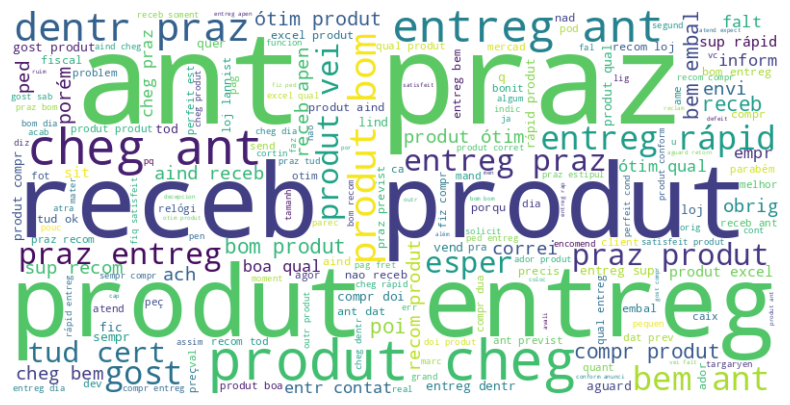

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Join all the cleaned review texts into a single string
all_cleaned_text = " ".join(df_reviews['cleaned_review'])

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_cleaned_text)

# Display the word cloud using matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

Se evidencia en la nube de palabras las palabras con mayor frecuencia de ocurrencia (praz o plazo, produt o producto, entreg o entrega, receb o recepcion, entre otros).

A continuacion, aplicamos misma metodologia separando los comentarios positivos de los negativos:

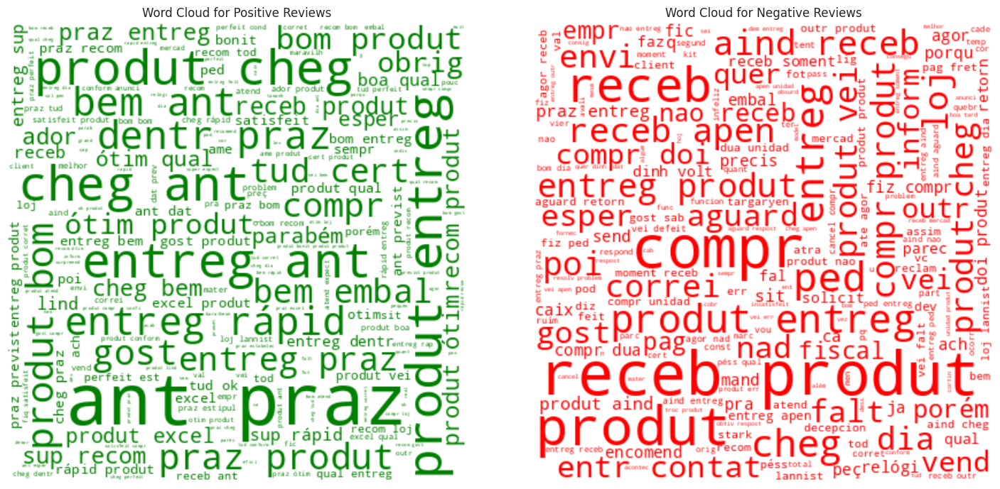

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Filter cleaned reviews for positive and negative sentiments
positive_reviews_text = " ".join(df_reviews[df_reviews['sentiment_label'] == 'positive']['cleaned_review'].dropna())
negative_reviews_text = " ".join(df_reviews[df_reviews['sentiment_label'] == 'negative']['cleaned_review'].dropna())

# Generate word cloud for positive reviews (green)
wordcloud_positive = WordCloud(width=400, height=400, background_color='white', color_func=lambda *args, **kwargs: "green").generate(positive_reviews_text)

# Generate word cloud for negative reviews (red)
wordcloud_negative = WordCloud(width=400, height=400, background_color='white', color_func=lambda *args, **kwargs: "red").generate(negative_reviews_text)

# Display the word clouds side-by-side
fig, axes = plt.subplots(1, 2, figsize=(15, 7))

axes[0].imshow(wordcloud_positive, interpolation='bilinear')
axes[0].set_title('Word Cloud for Positive Reviews')
axes[0].axis('off')

axes[1].imshow(wordcloud_negative, interpolation='bilinear')
axes[1].set_title('Word Cloud for Negative Reviews')
axes[1].axis('off')

plt.tight_layout()
plt.show()

Algunas conclusiones que podemos tomar son que:

* Producto aparece en ambos con importacia o frecuencia.
* En los comentarios positivos aparecen plazo, anticipacion, entrega con frecuencia alta.
* En los comentarios negativos aparecen los comentarios recepcion (receb), compra y entrega.

Exploramos ello con mejor detalle a continuacion realizando unigrama, bigramas y trigramas de comentarios positivos y negativos:

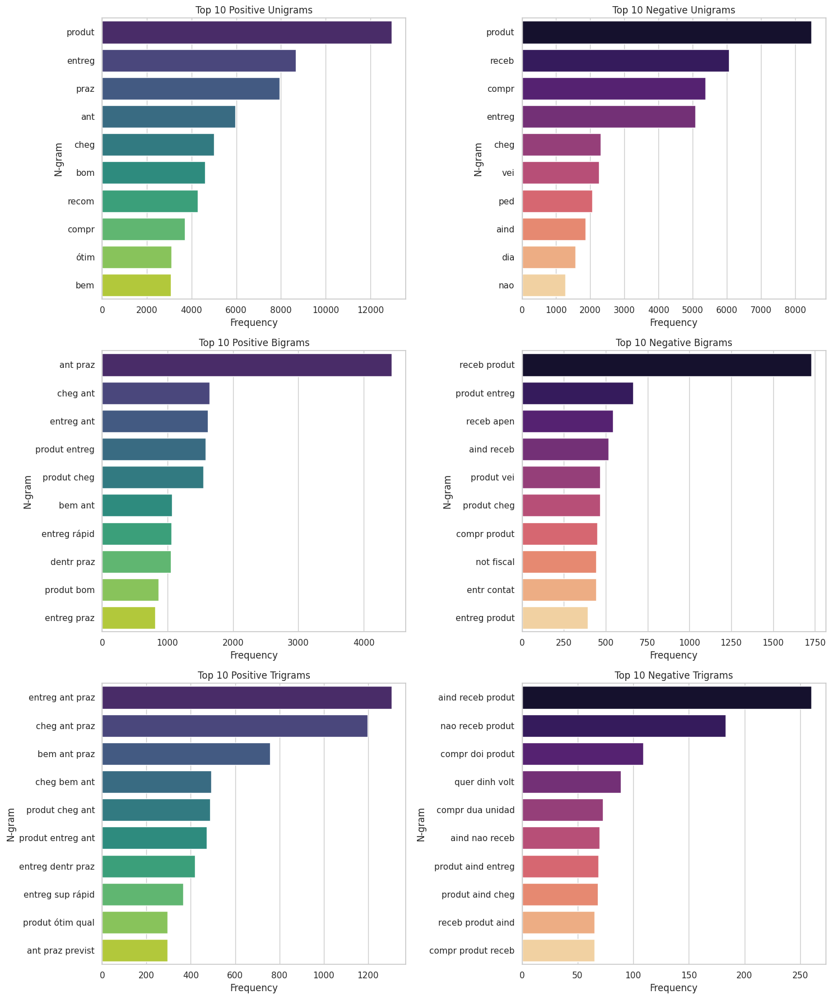

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer

def get_top_n_grams(corpus, n=None, gram_type=1):

    vec = CountVectorizer(ngram_range=(gram_type, gram_type)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
    return words_freq[:n]

# Separar las reseñas limpias por sentimiento
positive_reviews = df_reviews[df_reviews['sentiment_label'] == 'positive']['cleaned_review']
negative_reviews = df_reviews[df_reviews['sentiment_label'] == 'negative']['cleaned_review']

# Obtener los 10 unigramas, bigramas y trigramas más comunes para reseñas positivas
top_positive_unigrams = get_top_n_grams(positive_reviews, n=10, gram_type=1)
top_positive_bigrams = get_top_n_grams(positive_reviews, n=10, gram_type=2)
top_positive_trigrams = get_top_n_grams(positive_reviews, n=10, gram_type=3)

# Obtener los 10 unigramas, bigramas y trigramas más comunes para reseñas negativas
top_negative_unigrams = get_top_n_grams(negative_reviews, n=10, gram_type=1)
top_negative_bigrams = get_top_n_grams(negative_reviews, n=10, gram_type=2)
top_negative_trigrams = get_top_n_grams(negative_reviews, n=10, gram_type=3)

# Define a function to plot n-grams
def plot_n_grams(n_grams, title, ax, color):

    df_n_grams = pd.DataFrame(n_grams, columns=['N-gram', 'Frequency'])
    sns.barplot(x='Frequency', y='N-gram', data=df_n_grams, ax=ax, palette=color)
    ax.set_title(title)
    ax.set_xlabel('Frequency')
    ax.set_ylabel('N-gram')

# Create subplots for the n-gram plots
fig, axes = plt.subplots(3, 2, figsize=(15, 18)) # 3 rows (uni, bi, tri) x 2 columns (positive, negative)

# Plot unigrams
plot_n_grams(top_positive_unigrams, 'Top 10 Positive Unigrams', axes[0, 0], 'viridis')
plot_n_grams(top_negative_unigrams, 'Top 10 Negative Unigrams', axes[0, 1], 'magma')

# Plot bigrams
plot_n_grams(top_positive_bigrams, 'Top 10 Positive Bigrams', axes[1, 0], 'viridis')
plot_n_grams(top_negative_bigrams, 'Top 10 Negative Bigrams', axes[1, 1], 'magma')

# Plot trigrams
plot_n_grams(top_positive_trigrams, 'Top 10 Positive Trigrams', axes[2, 0], 'viridis')
plot_n_grams(top_negative_trigrams, 'Top 10 Negative Trigrams', axes[2, 1], 'magma')

plt.tight_layout()
plt.show()

Average Review Length by Sentiment:


,review_length
sentiment_label,
negative,101.9315
neutral,85.8788
positive,54.8957


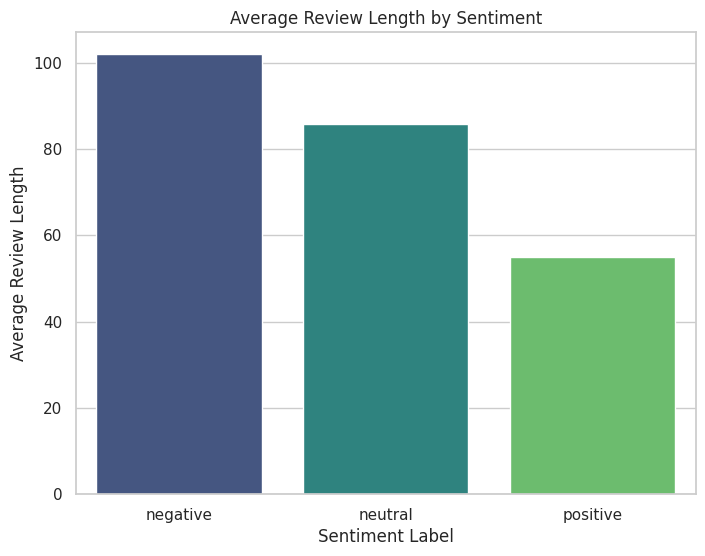

In [53]:
# Calculate the length of each review comment
df_reviews['review_length'] = df_reviews['review_comment_message'].str.len()

# Calculate the average review length for each sentiment label
average_length_by_sentiment = df_reviews.groupby('sentiment_label')['review_length'].mean()

print("Average Review Length by Sentiment:")
display(average_length_by_sentiment)

# Optional: Visualize the average lengths
plt.figure(figsize=(8, 6))
sns.barplot(x=average_length_by_sentiment.index, y=average_length_by_sentiment.values, palette='viridis')
plt.title('Average Review Length by Sentiment')
plt.xlabel('Sentiment Label')
plt.ylabel('Average Review Length')
plt.show()

##### 5.1.3 Labeling (etiquetado)

Convertimos a continuacion las evaluaciones en etiquetas de sentimientos (positivo, neutral y negativo).

Se aplican al dataframe generado.

In [8]:
# Definimos una función para asignar puntajes de reseñas a etiquetas de sentimiento
def get_sentiment_label(score):
    if score >= 4:
        return 'positive'
    elif score == 3:
        return 'neutral'
    else:
        return 'negative'

# Aplicamos la función para crear la columna 'sentiment_label'
df_reviews['sentiment_label'] = df_reviews['review_score'].apply(get_sentiment_label)

# Visualizamos el conteo de valores de la columna 'sentiment_label'
print("Distribution of Sentiment Labels:")
display(df_reviews['sentiment_label'].value_counts())

Distribution of Sentiment Labels:


,count
sentiment_label,
positive,30903
negative,15132
neutral,4630


##### 5.1.4 Pre procesamiento de datos

Como parte del pre procesamiento de los datos realizamos:

1- Limpiamos el texto de la reseña eliminando puntuación, caracteres especiales, números y convirtiendo el texto a minúsculas.

2- Tokenizar el texto (dividir en palabras) y eliminar las palabras vacías (palabras comunes como 'el', 'un', 'es').

3- Por ultimo, aplicamos stemming para reducir las palabras a su forma raíz

In [9]:
import re
import nltk
from nltk.corpus import stopwords
from nltk.stem import RSLPStemmer

# Descargamos los datos necesarios de NLTK
nltk.download('stopwords')
nltk.download('rslp')

# Inicializamos las palabras vacías y el stemmer del portugués
stop_words = set(stopwords.words('portuguese'))
stemmer = RSLPStemmer()

# Define la función de preprocesamiento
def preprocess_text(text):
    # Verifica si la entrada es una cadena; si no, devuelve una cadena vacía
    if not isinstance(text, str):
        return ""
    # Convertir texto a minúsculas
    text = text.lower()
    # Eliminar signos de puntuación y caracteres especiales
    text = re.sub(r'[^\w\s]', '', text)
    # Eliminar números
    text = re.sub(r'\d+', '', text)
    # Tokenizar el texto
    words = text.split()
    # Eliminar palabras vacías y aplicar la derivación
    words = [stemmer.stem(word) for word in words if word not in stop_words]
    # Unir palabras de nuevo en una cadena
    return ' '.join(words)

# Aplica la función de preprocesamiento a la columna 'review_comment_message'
df_reviews['cleaned_review'] = df_reviews['review_comment_message'].apply(preprocess_text)

# Muestra las primeras filas de df_reviews incluyendo la nueva columna 'cleaned_review'
display(df_reviews.head())

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package rslp to /root/nltk_data...
[nltk_data]   Unzipping stemmers/rslp.zip.


,review_comment_message,review_score,sentiment_label,cleaned_review
0,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",4,positive,test produt aind vei corret boa cond apen caix vei bem amass danific fic chat poi trat pres
1,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",4,positive,test produt aind vei corret boa cond apen caix vei bem amass danific fic chat poi trat pres
2,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",4,positive,test produt aind vei corret boa cond apen caix vei bem amass danific fic chat poi trat pres
3,Muito bom o produto.,4,positive,bom produt
5,O produto foi exatamente o que eu esperava e estava descrito no site e chegou bem antes da data prevista.,5,positive,produt exat esper descrit sit cheg bem ant dat prev


##### 5.1.5 Featuring

Convertimos el texto preprocesado en características numéricas que un modelo de aprendizaje automático pueda entender.

En este caso, Convertimos los datos de texto limpios en características numéricas utilizando la vectorización TF-IDF.

In [10]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Establecemos max_features para limitar el número de características y mantener manejable la matriz de características
tfidf_vectorizer = TfidfVectorizer(max_features=5000)

# Ajustamos y transformamos el texto de la reseña limpia
X = tfidf_vectorizer.fit_transform(df_reviews['cleaned_review'])

# Visualizamos la forma de la matriz TF-IDF resultante
print(f"Shape of the TF-IDF matrix (X): {X.shape}")

Shape of the TF-IDF matrix (X): (50665, 5000)


##### 5.1.6 Split Data

Dividimos el conjunto de datos en conjuntos de entrenamiento (30%) y prueba (70%) para evaluar el rendimiento del modelo en datos no vistos.

In [14]:
from sklearn.model_selection import train_test_split

# Definir características (X) y objetivo (y)
X = X  # X es la matriz TF-IDF del paso anterior
y = df_reviews['sentiment_label'] # y son las etiquetas de sentimiento

# Divide los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

##### 5.1.7 Regresion logistica

Entrenamos el modelo de regresion logistica para predecir los sentimientos (positivo, neutro o negativo) utilizando el dataset de entrenamiento (30% de los datos iniciales).



In [15]:
from sklearn.linear_model import LogisticRegression

# Instantiate the Logistic Regression model
sentiment_model = LogisticRegression()

# Train the model
sentiment_model.fit(X_train, y_train)

LogisticRegression()

###### 5.1.7.1 Evaluacion del modelo

In [16]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Make predictions on the test set
y_pred = sentiment_model.predict(X_test)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-score: {f1:.4f}")

Accuracy: 0.8403
Precision: 0.8104
Recall: 0.8403
F1-score: 0.8139


Las metricas establecen que en promedio el modelo predice bastante bien los resultados.

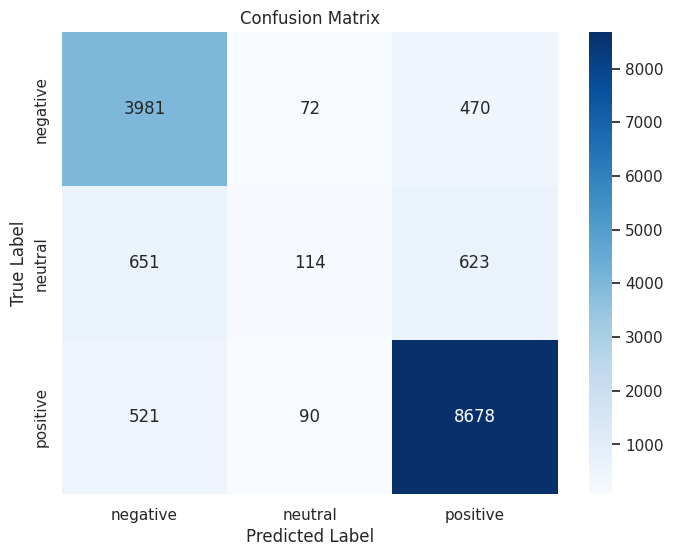

In [17]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Generate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Get the class labels
class_labels = sentiment_model.classes_

# Create a heatmap for the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

  Queda claro en la matriz de confusion que el modelo predice mejor los positivos que realmente fueron positivos.

 Los datos predecidos como negativos que efectivamente fueron negativos tambien tienen una prediccion bastante aceptable.

 Por el contrario, los datos neutrales no tienen una buena performance en la prediccion.

 Esto lo vislumbramos en la etapa de Labeling, donde ya se observaba un desbalanceo de clases.

###### 5.1.7.2 Ajustes de hiperparametros

In [18]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

# Define the parameter grid to search over
param_grid = {
    'C': [0.1, 1, 10, 100],  # Regularization parameter
    'penalty': ['l2']  # Using L2 penalty, 'l1' and 'elasticnet' require 'liblinear' or 'saga' solver
}

# Instantiate the GridSearchCV object
# Using f1_weighted as scoring metric to account for class imbalance
grid_search = GridSearchCV(LogisticRegression(solver='liblinear'), param_grid, cv=5, scoring='f1_weighted', n_jobs=-1)

# Fit the grid search to the training data
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=LogisticRegression(solver='liblinear'), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10, 100], 'penalty': ['l2']},
             scoring='f1_weighted')

In [19]:
# Print the best hyperparameters found
print("Best hyperparameters found:")
print(grid_search.best_params_)

# Print the best score achieved during the tuning process
print("\nBest cross-validation F1-score (weighted):")
print(grid_search.best_score_)

Best hyperparameters found:
{'C': 10, 'penalty': 'l2'}

Best cross-validation F1-score (weighted):
0.8221073419881788


In [20]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Get the best model from the grid search
best_model = grid_search.best_estimator_

# Make predictions on the test set using the best model
y_pred_tuned = best_model.predict(X_test)

# Calculate evaluation metrics for the tuned model
accuracy_tuned = accuracy_score(y_test, y_pred_tuned)
precision_tuned = precision_score(y_test, y_pred_tuned, average='weighted')
recall_tuned = recall_score(y_test, y_pred_tuned, average='weighted')
f1_tuned = f1_score(y_test, y_pred_tuned, average='weighted')

# Print the evaluation metrics for the tuned model
print("Evaluation metrics for the tuned model on the test set:")
print(f"Accuracy: {accuracy_tuned:.4f}")
print(f"Precision: {precision_tuned:.4f}")
print(f"Recall: {recall_tuned:.4f}")
print(f"F1-score: {f1_tuned:.4f}")

Evaluation metrics for the tuned model on the test set:
Accuracy: 0.8434
Precision: 0.8225
Recall: 0.8434
F1-score: 0.8253


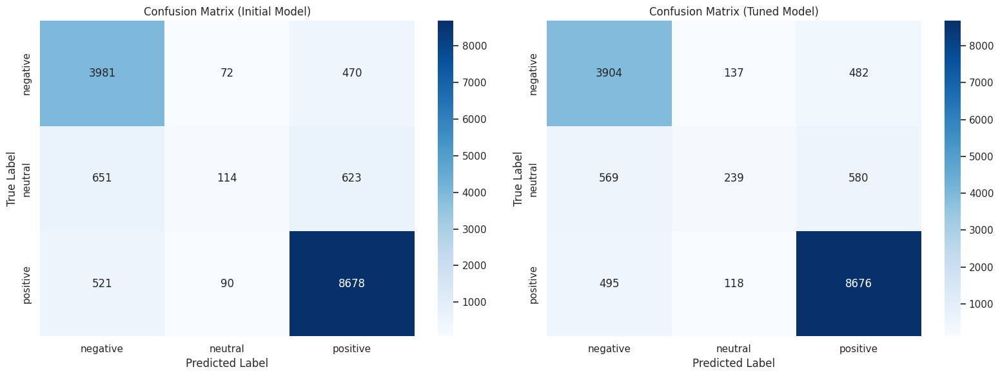

In [21]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Generate the confusion matrix for the initial model
cm_initial = confusion_matrix(y_test, y_pred)

# Generate the confusion matrix for the tuned model
cm_tuned = confusion_matrix(y_test, y_pred_tuned)

# Get the class labels (assuming they are the same for both models)
class_labels = sentiment_model.classes_

# Create subplots for the two confusion matrices side-by-side
fig, axes = plt.subplots(1, 2, figsize=(16, 6)) # Adjust figure size as needed

# Plot for the initial model's confusion matrix
sns.heatmap(cm_initial, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels, ax=axes[0])
axes[0].set_title('Confusion Matrix (Initial Model)')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot for the tuned model's confusion matrix
sns.heatmap(cm_tuned, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels, ax=axes[1])
axes[1].set_title('Confusion Matrix (Tuned Model)')
axes[1].set_xlabel('Predicted Label')
axes[1].set_ylabel('True Label')

plt.tight_layout()
plt.show()

Queda claro que el ajuste de parametros ha mejorado las metricas aunque no sustancialmente.

Al evaluar y comparar ambas matrices de confusion, el modelo con y sin ajuste de hiperparamtetro predice muy bien y con igualdad de precision los positivos que realmente son positivos.

De todas formas, con el ajuste de parametros se ha mejorado la prediccion de evaluaciones neustras que efectivamente han sido neutras. En contrapartida, se ha desmejorado la prediccion de casos negativos que efectivamente han sido negativos.

###### 5.1.7.3 Prediccion e interpretacion

A continuacion se utiliza el modelo entrenado para predecir el sentimiento en nuevas reseñas no vistas.

Se interpreta las predicciones del modelo y, potencialmente, analiza qué palabras o características contribuyen más al sentimiento positivo o negativo.

In [22]:
# 1. Select a few sample review comments from the original df DataFrame
sample_reviews = df_reviews['review_comment_message'].sample(5, random_state=100) # Select 5 random samples

print("Original Sample Reviews:")
for i, review in enumerate(sample_reviews):
    print(f"Sample {i+1}: {review}")

# 2. Preprocess these sample reviews using the preprocess_text function defined earlier
preprocessed_samples = [preprocess_text(review) for review in sample_reviews]

print("\nPreprocessed Sample Reviews:")
for i, review in enumerate(preprocessed_samples):
    print(f"Sample {i+1}: {review}")

# 3. Transform the preprocessed sample reviews into the same numerical feature representation (TF-IDF)
#    Use the fitted tfidf_vectorizer from the previous step
X_sample = tfidf_vectorizer.transform(preprocessed_samples)

print(f"\nShape of the TF-IDF matrix for samples: {X_sample.shape}")

# 4. Use the trained sentiment analysis model to predict the sentiment label for each sample review
#    Using best_model from hyperparameter tuning
sample_predictions = best_model.predict(X_sample)

# 5. Display the original review text and the predicted sentiment label for each sample
print("\nSentiment Predictions for Sample Reviews:")
for i, review, prediction in zip(range(len(sample_reviews)), sample_reviews, sample_predictions):
    print(f"Original Review {i+1}: {review}")
    print(f"Predicted Sentiment: {prediction}")
    print("-" * 30)

Original Sample Reviews:
Sample 1: Recebi no prazo, e estou satisfeita. Recomendo o site. 
Sample 2: Entrega rápida e produto de qualidade.

Sample 3: Porém chegou sem as baterias.
Sample 4: Muito feliz com a compra, amei o relógio
Sample 5: Eu ja tinha comprado um mas era maior esse que veio agora e bem menor do que o anterior

Preprocessed Sample Reviews:
Sample 1: receb praz satisfeit recom sit
Sample 2: entreg rápid produt qual
Sample 3: porém cheg bat
Sample 4: feliz compr ame relógi
Sample 5: ja compr mai vei agor bem men anteri

Shape of the TF-IDF matrix for samples: (5, 5000)

Sentiment Predictions for Sample Reviews:
Original Review 1: Recebi no prazo, e estou satisfeita. Recomendo o site. 
Predicted Sentiment: positive
------------------------------
Original Review 2: Entrega rápida e produto de qualidade.

Predicted Sentiment: positive
------------------------------
Original Review 3: Porém chegou sem as baterias.
Predicted Sentiment: positive
------------------------------

In [23]:
import numpy as np

# Select one sample review for feature importance analysis (e.g., the first one)
sample_index_for_analysis = 0
original_review_analysis = sample_reviews.iloc[sample_index_for_analysis]
preprocessed_review_analysis = preprocessed_samples[sample_index_for_analysis]
X_analysis = X_sample[sample_index_for_analysis]

print(f"Analyzing feature importance for Sample Review {sample_index_for_analysis + 1}:")
print(f"Original: {original_review_analysis}")
print(f"Preprocessed: {preprocessed_review_analysis}")

# Get the feature names from the TF-IDF vectorizer
feature_names = np.array(tfidf_vectorizer.get_feature_names_out())

# Get the model coefficients for the predicted class of the sample review
# For Logistic Regression, coefficients are in model.coef_
# The class order can be obtained from model.classes_
predicted_class = best_model.predict(X_analysis)[0]
predicted_class_index = np.where(best_model.classes_ == predicted_class)[0][0]
coefficients = best_model.coef_[predicted_class_index]

# Get the non-zero features (words) in the sample review and their TF-IDF scores
# Also get the corresponding coefficients from the model
feature_indices = X_analysis.nonzero()[1]
tfidf_scores = X_analysis.data
corresponding_coefficients = coefficients[feature_indices]

# Create a DataFrame to show the words, their TF-IDF scores, and model coefficients
feature_importance_df = pd.DataFrame({
    'Word': feature_names[feature_indices],
    'TFIDF_Score': tfidf_scores,
    'Coefficient': corresponding_coefficients,
    'Importance': tfidf_scores * corresponding_coefficients # Importance is the product of TF-IDF score and coefficient
})

# Sort by the absolute importance to find the most influential words
feature_importance_df['Abs_Importance'] = feature_importance_df['Importance'].abs()
feature_importance_df = feature_importance_df.sort_values(by='Abs_Importance', ascending=False)

# Display the top features contributing to the prediction
print(f"\nTop features contributing to the predicted '{predicted_class}' sentiment:")
display(feature_importance_df.head(10)) # Display top 10 most important words

# Display features with the highest positive and negative coefficients (optional)
# This gives an idea of which words generally push the prediction towards this class
print(f"\nFeatures with the highest positive coefficients for '{predicted_class}' sentiment:")
display(feature_importance_df.sort_values(by='Coefficient', ascending=False).head(10))

print(f"\nFeatures with the lowest negative coefficients for '{predicted_class}' sentiment:")
display(feature_importance_df.sort_values(by='Coefficient', ascending=True).head(10))

Analyzing feature importance for Sample Review 1:
Original: Recebi no prazo, e estou satisfeita. Recomendo o site. 
Preprocessed: receb praz satisfeit recom sit

Top features contributing to the predicted 'positive' sentiment:


,Word,TFIDF_Score,Coefficient,Importance,Abs_Importance
3,satisfeit,0.552088,4.017304,2.217905,2.217905
0,praz,0.326416,3.470367,1.132783,1.132783
1,receb,0.339997,-3.160436,-1.074540,1.074540
2,recom,0.407226,2.551308,1.038959,1.038959
4,sit,0.554275,0.159508,0.088411,0.088411



Features with the highest positive coefficients for 'positive' sentiment:


,Word,TFIDF_Score,Coefficient,Importance,Abs_Importance
3,satisfeit,0.552088,4.017304,2.217905,2.217905
0,praz,0.326416,3.470367,1.132783,1.132783
2,recom,0.407226,2.551308,1.038959,1.038959
4,sit,0.554275,0.159508,0.088411,0.088411
1,receb,0.339997,-3.160436,-1.074540,1.074540



Features with the lowest negative coefficients for 'positive' sentiment:


,Word,TFIDF_Score,Coefficient,Importance,Abs_Importance
1,receb,0.339997,-3.160436,-1.074540,1.074540
4,sit,0.554275,0.159508,0.088411,0.088411
2,recom,0.407226,2.551308,1.038959,1.038959
0,praz,0.326416,3.470367,1.132783,1.132783
3,satisfeit,0.552088,4.017304,2.217905,2.217905


Se observan anteriormente los resultados de un análisis de importancia de características para una reseña específica que el modelo predijo como 'positiva'.

Esto nos ayuda a entender qué palabras en esa reseña fueron las más influyentes en la decisión del modelo.

Claramente, las palabras mas influyentes en un comentario positivo son plazo, receb (de recibir) y recom (de recomiendo).

La que menor influencia tiene es la de sit (derivada de site o sitio WEB).

##### 5.1.8 Support Vector Machine (SVM)

Aplicamos modelo de SVM tomando los datos ya separados para entrenamiento y validacion en punto 5.1.6

###### 5.1.8.1 Evaluacion del modelo

Evaluation metrics for the Linear SVM model on the test set:
Accuracy: 0.8428
Precision: 0.8222
Recall: 0.8428
F1-score: 0.8229

Classification Report (Linear SVM):
              precision    recall  f1-score   support

    negative       0.78      0.87      0.82      4523
     neutral       0.51      0.16      0.24      1388
    positive       0.89      0.93      0.91      9289

    accuracy                           0.84     15200
   macro avg       0.73      0.65      0.66     15200
weighted avg       0.82      0.84      0.82     15200



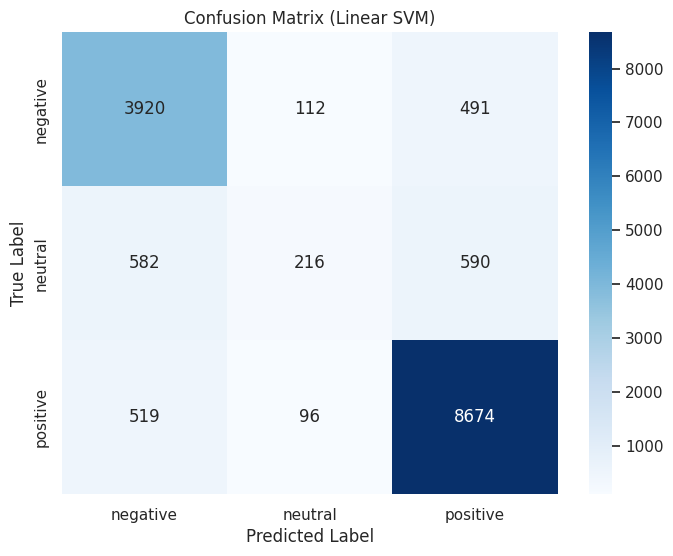

In [34]:
from sklearn.svm import LinearSVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Instantiate the Linear SVC model
svm_model = LinearSVC(random_state=42)

# Train the model using the training data
svm_model.fit(X_train, y_train)

# Make predictions on the test set
y_pred_svm = svm_model.predict(X_test)

# Calculate evaluation metrics
accuracy_svm = accuracy_score(y_test, y_pred_svm)
precision_svm = precision_score(y_test, y_pred_svm, average='weighted')
recall_svm = recall_score(y_test, y_pred_svm, average='weighted')
f1_svm = f1_score(y_test, y_pred_svm, average='weighted')

# Print the evaluation metrics for the SVM model
print("Evaluation metrics for the Linear SVM model on the test set:")
print(f"Accuracy: {accuracy_svm:.4f}")
print(f"Precision: {precision_svm:.4f}")
print(f"Recall: {recall_svm:.4f}")
print(f"F1-score: {f1_svm:.4f}")

# Print classification report
print("\nClassification Report (Linear SVM):")
print(classification_report(y_test, y_pred_svm))

# Plot confusion matrix for SVM
cm_svm = confusion_matrix(y_test, y_pred_svm)

plt.figure(figsize=(8, 6))
sns.heatmap(cm_svm, annot=True, fmt='d', cmap='Blues', xticklabels=svm_model.classes_, yticklabels=svm_model.classes_)
plt.title('Confusion Matrix (Linear SVM)')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

###### 5.1.8.2 Ajustes de hiperparametros

In [38]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score

# Define the parameter grid for LinearSVC
# C is the regularization parameter. Smaller values specify stronger regularization.
param_grid_svm = {
    'C': [0.01, 0.1, 1, 10, 100]
}

# Instantiate the GridSearchCV object
# Using f1_weighted as scoring metric to account for class imbalance
grid_search_svm = GridSearchCV(LinearSVC(random_state=42, max_iter=1000), param_grid_svm, cv=5, scoring='f1_weighted', n_jobs=-1)

# Fit the grid search to the training data
# Use the X_train and y_train from the previous split for sentiment analysis
grid_search_svm.fit(X_train, y_train)

# Print the best hyperparameters found
print("Best hyperparameters found for Linear SVM:")
print(grid_search_svm.best_params_)

# Print the best score achieved during the tuning process
print("\nBest cross-validation F1-score (weighted) for Linear SVM:")
print(grid_search_svm.best_score_)

# Evaluate the best model on the test set
best_svm_model = grid_search_svm.best_estimator_
y_pred_tuned_svm = best_svm_model.predict(X_test)

# Print classification report for the tuned SVM model
print("\nClassification Report (Tuned Linear SVM):")
print(classification_report(y_test, y_pred_tuned_svm))

# Calculate evaluation metrics for the tuned SVM model and store them in variables
accuracy_tuned_svm = accuracy_score(y_test, y_pred_tuned_svm)
precision_tuned_svm = precision_score(y_test, y_pred_tuned_svm, average='weighted')
recall_tuned_svm = recall_score(y_test, y_pred_tuned_svm, average='weighted')
f1_tuned_svm = f1_score(y_test, y_pred_tuned_svm, average='weighted')

print("\nEvaluation metrics for the tuned Linear SVM model on the test set:")
print(f"Accuracy: {accuracy_tuned_svm:.4f}")
print(f"Precision: {precision_tuned_svm:.4f}")
print(f"Recall: {recall_tuned_svm:.4f}")
print(f"F1-score: {f1_tuned_svm:.4f}")

Best hyperparameters found for Linear SVM:
{'C': 1}

Best cross-validation F1-score (weighted) for Linear SVM:
0.8193150034254113

Classification Report (Tuned Linear SVM):
              precision    recall  f1-score   support

    negative       0.78      0.87      0.82      4523
     neutral       0.51      0.16      0.24      1388
    positive       0.89      0.93      0.91      9289

    accuracy                           0.84     15200
   macro avg       0.73      0.65      0.66     15200
weighted avg       0.82      0.84      0.82     15200


Evaluation metrics for the tuned Linear SVM model on the test set:
Accuracy: 0.8428
Precision: 0.8222
Recall: 0.8428
F1-score: 0.8229


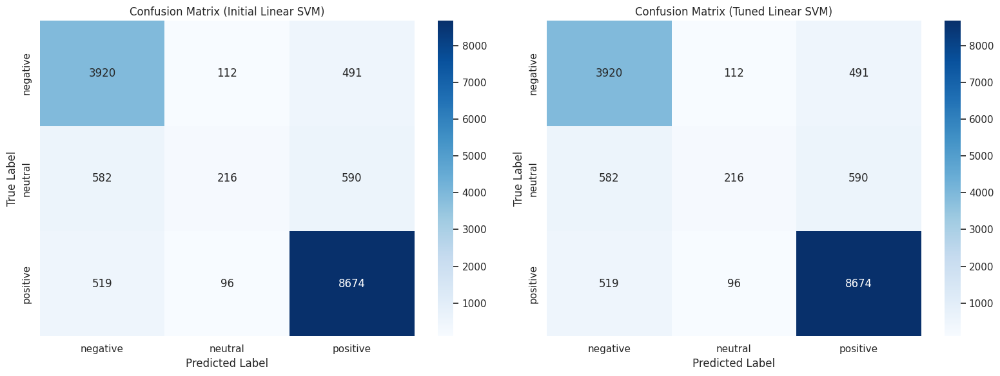

In [39]:
# Generate the confusion matrix for the initial model
cm_initial_svm = confusion_matrix(y_test, y_pred_svm)

# Generate the confusion matrix for the tuned model
cm_tuned_svm = confusion_matrix(y_test, y_pred_tuned_svm)

# Get the class labels (assuming they are the same for both models)
# You can get them from the trained model's classes_ attribute
class_labels_svm = best_svm_model.classes_


# Create subplots for the two confusion matrices side-by-side
fig, axes = plt.subplots(1, 2, figsize=(16, 6)) # Adjust figure size as needed

# Plot for the initial model's confusion matrix
sns.heatmap(cm_initial_svm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels_svm, yticklabels=class_labels_svm, ax=axes[0])
axes[0].set_title('Confusion Matrix (Initial Linear SVM)')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot for the tuned model's confusion matrix
sns.heatmap(cm_tuned_svm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels_svm, yticklabels=class_labels_svm, ax=axes[1])
axes[1].set_title('Confusion Matrix (Tuned Linear SVM)')
axes[1].set_xlabel('Predicted Label')
axes[1].set_ylabel('True Label')

plt.tight_layout()
plt.show()

Se evidencia que con el ajuste de hiperparametros propuesto no se logra en este caso ninguna variacion en el resultado.

##### 5.1.9 XGBOOST


Aplicamos modelo de XGBoost tomando los datos ya separados para entrenamiento y validacion en punto 5.1.6

###### 5.1.9.1 Evaluacion del modelo

Evaluation metrics for the XGBoost model on the test set:
Accuracy: 0.8363
Precision: 0.8138
Recall: 0.8363
F1-score: 0.8099

Classification Report (XGBoost):
              precision    recall  f1-score   support

    negative       0.77      0.86      0.81      4523
     neutral       0.53      0.09      0.16      1388
    positive       0.88      0.93      0.91      9289

    accuracy                           0.84     15200
   macro avg       0.73      0.63      0.63     15200
weighted avg       0.81      0.84      0.81     15200



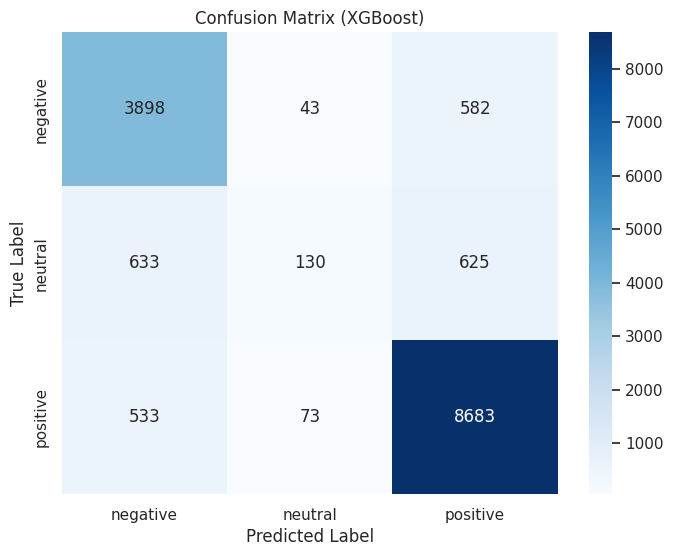

In [29]:
import xgboost as xgb
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Instantiate LabelEncoder and fit on the training labels
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

# Instantiate the XGBoost Classifier model
# Use 'multi:softmax' objective for multi-class classification
# num_class should be the number of unique sentiment labels (positive, neutral, negative)
xgb_model = xgb.XGBClassifier(objective='multi:softmax', num_class=len(label_encoder.classes_), use_label_encoder=False, eval_metric='mlogloss', random_state=42)

# Train the model using the encoded training data
# XGBoost can handle sparse matrices like the TF-IDF output
xgb_model.fit(X_train, y_train_encoded)

# Make predictions on the encoded test set
y_pred_xgb_encoded = xgb_model.predict(X_test)

# Decode the predictions back to original labels for evaluation
y_pred_xgb = label_encoder.inverse_transform(y_pred_xgb_encoded)


# Calculate evaluation metrics using the original test labels and decoded predictions
accuracy_xgb = accuracy_score(y_test, y_pred_xgb)
precision_xgb = precision_score(y_test, y_pred_xgb, average='weighted')
recall_xgb = recall_score(y_test, y_pred_xgb, average='weighted')
f1_xgb = f1_score(y_test, y_pred_xgb, average='weighted')

# Print the evaluation metrics for the XGBoost model
print("Evaluation metrics for the XGBoost model on the test set:")
print(f"Accuracy: {accuracy_xgb:.4f}")
print(f"Precision: {precision_xgb:.4f}")
print(f"Recall: {recall_xgb:.4f}")
print(f"F1-score: {f1_xgb:.4f}")

# Print classification report
print("\nClassification Report (XGBoost):")
print(classification_report(y_test, y_pred_xgb))

# Plot confusion matrix for XGBoost
cm_xgb = confusion_matrix(y_test, y_pred_xgb)

plt.figure(figsize=(8, 6))
# Get the class labels for the confusion matrix from the label encoder
class_labels_xgb = label_encoder.classes_
sns.heatmap(cm_xgb, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels_xgb, yticklabels=class_labels_xgb)
plt.title('Confusion Matrix (XGBoost)')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

###### 5.1.9.2 Ajustes de hiperparametros

In [41]:
from sklearn.model_selection import RandomizedSearchCV # Use RandomizedSearchCV
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score
import xgboost as xgb
from sklearn.preprocessing import LabelEncoder
import warnings
warnings.filterwarnings('ignore') # Suppress warnings, especially about use_label_encoder

# Instantiate LabelEncoder and fit on the training labels if not already done
# (Assuming y_train and y_test are the original string labels)
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

# Define the parameter distribution for RandomizedSearchCV
# Use distributions instead of fixed lists for continuous parameters if needed
# This grid is kept relatively small for faster execution as requested
param_dist_xgb = {
    'n_estimators': [50, 100, 150, 200], # Number of boosting rounds
    'learning_rate': [0.01, 0.05, 0.1, 0.2], # Step size shrinkage
    'max_depth': [3, 4, 5, 6], # Maximum depth of a tree
    'colsample_bytree': [0.7, 0.8, 0.9, 1.0], # Subsample ratio of columns when constructing each tree
    'subsample': [0.7, 0.8, 0.9, 1.0] # Subsample ratio of the training instances
}

# Instantiate the RandomizedSearchCV object
# Set n_iter to control the number of parameter combinations sampled (adjust based on desired time)
# cv=3 for cross-validation
# scoring='f1_weighted' to account for class imbalance
# n_jobs=-1 to use all available cores
random_search_xgb = RandomizedSearchCV(xgb.XGBClassifier(objective='multi:softmax', num_class=len(label_encoder.classes_), use_label_encoder=False, eval_metric='mlogloss', random_state=42),
                                     param_distributions=param_dist_xgb,
                                     n_iter=10, # Number of parameter settings that are sampled. Adjust this to control execution time.
                                     cv=3,
                                     scoring='f1_weighted',
                                     n_jobs=-1,
                                     random_state=42)

# Fit the random search to the encoded training data
print("Starting Randomized Search for XGBoost...")
random_search_xgb.fit(X_train, y_train_encoded)
print("Randomized Search for XGBoost finished.")

# Print the best hyperparameters found
print("\nBest hyperparameters found for XGBoost:")
print(random_search_xgb.best_params_)

# Print the best score achieved during the tuning process
print("\nBest cross-validation F1-score (weighted) for XGBoost:")
print(random_search_xgb.best_score_)

# Evaluate the best model on the encoded test set
best_xgb_model = random_search_xgb.best_estimator_
y_pred_tuned_xgb_encoded = best_xgb_model.predict(X_test)

# Decode the predictions back to original labels for evaluation
y_pred_tuned_xgb = label_encoder.inverse_transform(y_pred_tuned_xgb_encoded)

# Print classification report for the tuned XGBoost model
print("\nClassification Report (Tuned XGBoost):")
print(classification_report(y_test, y_pred_tuned_xgb))

# Calculate evaluation metrics for the tuned XGBoost model and store them in variables
accuracy_tuned_xgb = accuracy_score(y_test, y_pred_tuned_xgb)
precision_tuned_xgb = precision_score(y_test, y_pred_tuned_xgb, average='weighted')
recall_tuned_xgb = recall_score(y_test, y_pred_tuned_xgb, average='weighted')
f1_tuned_xgb = f1_score(y_test, y_pred_tuned_xgb, average='weighted')

print("\nEvaluation metrics for the tuned XGBoost model on the test set:")
print(f"Accuracy: {accuracy_tuned_xgb:.4f}")
print(f"Precision: {precision_tuned_xgb:.4f}")
print(f"Recall: {recall_tuned_xgb:.4f}")
print(f"F1-score: {f1_tuned_xgb:.4f}")

Starting Randomized Search for XGBoost...
Randomized Search for XGBoost finished.

Best hyperparameters found for XGBoost:
{'subsample': 0.7, 'n_estimators': 200, 'max_depth': 6, 'learning_rate': 0.1, 'colsample_bytree': 0.9}

Best cross-validation F1-score (weighted) for XGBoost:
0.8005480988557157

Classification Report (Tuned XGBoost):
              precision    recall  f1-score   support

    negative       0.76      0.86      0.81      4523
     neutral       0.55      0.08      0.13      1388
    positive       0.87      0.93      0.90      9289

    accuracy                           0.83     15200
   macro avg       0.73      0.62      0.62     15200
weighted avg       0.81      0.83      0.80     15200


Evaluation metrics for the tuned XGBoost model on the test set:
Accuracy: 0.8332
Precision: 0.8122
Recall: 0.8332
F1-score: 0.8047


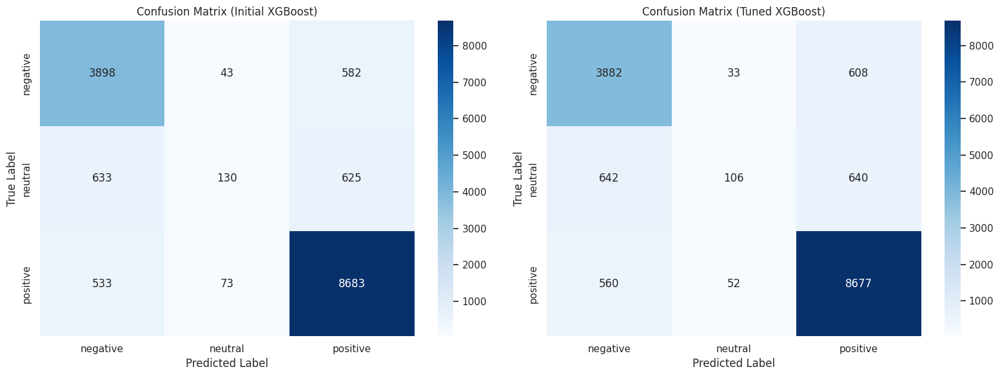

In [44]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming y_test (true labels), y_pred_xgb (initial predictions), and y_pred_tuned_xgb (tuned predictions) are available
# Assuming label_encoder is available from the previous step

# Generate the confusion matrix for the initial XGBoost model
cm_initial_xgb = confusion_matrix(y_test, y_pred_xgb)

# Generate the confusion matrix for the tuned XGBoost model
cm_tuned_xgb = confusion_matrix(y_test, y_pred_tuned_xgb)

# Get the class labels from the label encoder
class_labels_xgb = label_encoder.classes_

# Create subplots for the two confusion matrices side-by-side
fig, axes = plt.subplots(1, 2, figsize=(16, 6)) # Adjust figure size as needed

# Plot for the initial model's confusion matrix
sns.heatmap(cm_initial_xgb, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels_xgb, yticklabels=class_labels_xgb, ax=axes[0])
axes[0].set_title('Confusion Matrix (Initial XGBoost)')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot for the tuned model's confusion matrix
sns.heatmap(cm_tuned_xgb, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels_xgb, yticklabels=class_labels_xgb, ax=axes[1])
axes[1].set_title('Confusion Matrix (Tuned XGBoost)')
axes[1].set_xlabel('Predicted Label')
axes[1].set_ylabel('True Label')

plt.tight_layout()
plt.show()

Se evidencia que con el ajuste de hiperparametros propuesto no se logra en este caso una mejora en el resultado, sino que por el contrario, una leve reduccion de predicciones correctas.

##### 5.1.10 Comparacion de los 3 modelos (con y sin ajustes de hiperparametros)

In [45]:
# Create a dictionary with the results for each model
results = {
    'Model': [
        'Logistic Regression (Initial)', 'Logistic Regression (Tuned)',
        'Linear SVM (Initial)', 'Linear SVM (Tuned)',
        'XGBoost (Initial)', 'XGBoost (Tuned)'
    ],
    'Accuracy': [
        accuracy, accuracy_tuned,
        accuracy_svm, accuracy_tuned_svm,
        accuracy_xgb, accuracy_tuned_xgb
    ],
    'Precision (Weighted)': [
        precision, precision_tuned,
        precision_svm, precision_tuned_svm,
        precision_xgb, precision_tuned_xgb
    ],
    'Recall (Weighted)': [
        recall, recall_tuned,
        recall_svm, recall_tuned_svm,
        recall_xgb, recall_tuned_xgb
    ],
    'F1-score (Weighted)': [
        f1, f1_tuned,
        f1_svm, f1_tuned_svm,
        f1_xgb, f1_tuned_xgb
    ]
}

# Create a pandas DataFrame from the results dictionary
results_df = pd.DataFrame(results)

# Set display options for better readability
pd.set_option('display.float_format', '{:.4f}'.format)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)

# Display the comparison table
print("Model Performance Comparison:")
display(results_df)

Model Performance Comparison:


,Model,Accuracy,Precision (Weighted),Recall (Weighted),F1-score (Weighted)
0,Logistic Regression (Initial),0.8403,0.8104,0.8403,0.8139
1,Logistic Regression (Tuned),0.8434,0.8225,0.8434,0.8253
2,Linear SVM (Initial),0.8428,0.8222,0.8428,0.8229
3,Linear SVM (Tuned),0.8428,0.8222,0.8428,0.8229
4,XGBoost (Initial),0.8363,0.8138,0.8363,0.8099
5,XGBoost (Tuned),0.8332,0.8122,0.8332,0.8047


Queda claro entonces que el mejor modelo aplicado fue el de regresion logistica con el ajuste de hiperparametros propuesto.

### 5.2 Red Neuronal para Prediccion de Puntuacion de reseñas

A continuacion aplicaremos una red neuronal para predecir directamente la puntuación de la reseña (review_score).

Como la puntuación es un valor discreto (1-5), esto puede tratarse como un problema de clasificación o, si queremos predecir el valor exacto, como un problema de regresión.

Dada la naturaleza de las puntuaciones de revisión (generalmente discretas y ordenadas), un enfoque de clasificación o regresión con una capa de salida adecuada (por ejemplo, 5 unidades para clasificación si se trata como one-hot encoding o 1 unidad para regresión) puede ser adecuado.

Para simplificar, utilizaremos un enfoque de clasificación multiclase donde cada puntuación (1 a 5) es una clase.

Primero, necesitamos ajustar nuestras etiquetas para que sean compatibles con un modelo de clasificación, por ejemplo, usando codificación one-hot o simplemente usando las etiquetas numéricas originales (1-5) si el modelo lo soporta y se utiliza una función de pérdida adecuada.

Vamos a usar las puntuaciones numéricas originales (1-5) y tratarlo como un problema de clasificación, utilizando una función de pérdida compatible y métricas de evaluación.

In [46]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
import numpy as np

# Convert review scores to a format suitable for classification (e.g., one-hot encoding)
# Since scores are 1-5, we can adjust them to be 0-4 for one-hot encoding.
y_scores = df_reviews['review_score'].values - 1 # Adjusting scores from 1-5 to 0-4
y_scores_categorical = to_categorical(y_scores, num_classes=5)

# Split data into training and testing sets
# Use the TF-IDF features (X) and the categorical scores (y_scores_categorical)
X_train_nn, X_test_nn, y_train_nn, y_test_nn = train_test_split(X, y_scores_categorical, test_size=0.3, random_state=42)

# Define the neural network model
model = Sequential()
model.add(Dense(128, input_shape=(X_train_nn.shape[1],), activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(5, activation='softmax')) # 5 output units for 5 classes (scores 1-5)

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

# Display the model summary
model.summary()

# Train the model
history = model.fit(X_train_nn, y_train_nn, epochs=10, batch_size=32, validation_split=0.2)

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 128)            │       640,128 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 5)              │           325 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 648,709 (2.47 MB)

 Trainable params: 648,709 (2.47 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
887/887 ━━━━━━━━━━━━━━━━━━━━ 15s 15ms/step - accuracy: 0.5830 - loss: 1.1456 - val_accuracy: 0.6661 - val_loss: 0.9040
Epoch 2/10
887/887 ━━━━━━━━━━━━━━━━━━━━ 11s 12ms/step - accuracy: 0.6893 - loss: 0.8634 - val_accuracy: 0.6795 - val_loss: 0.8777
Epoch 3/10
887/887 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - accuracy: 0.7131 - loss: 0.7944 - val_accuracy: 0.6855 - val_loss: 0.8720
Epoch 4/10
887/887 ━━━━━━━━━━━━━━━━━━━━ 11s 12ms/step - accuracy: 0.7343 - loss: 0.7421 - val_accuracy: 0.6896 - val_loss: 0.8824
Epoch 5/10
887/887 ━━━━━━━━━━━━━━━━━━━━ 16s 18ms/step - accuracy: 0.7516 - loss: 0.7038 - val_accuracy: 0.6948 - val_loss: 0.8951
Epoch 6/10
887/887 ━━━━━━━━━━━━━━━━━━━━ 11s 12ms/step - accuracy: 0.7681 - loss: 0.6602 - val_accuracy: 0.6951 - val_loss: 0.9030
Epoch 7/10
887/887 ━━━━━━━━━━━━━━━━━━━━ 11s 12ms/step - accuracy: 0.7830 - loss: 0.6239 - val_accuracy: 0.6949 - val_loss: 0.9120
Epoch 8/10
887/887 ━━━━━━━━━━━━━━━━━━━━ 11s 12ms/step - accuracy: 0.7922 - loss: 0.5920 - v

#### 5.2.1 Evaluacion del modelo de Red Neuronal

Test Accuracy: 0.7074
Test Loss: 0.9665
475/475 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

Classification Report:
              precision    recall  f1-score   support

           1       0.72      0.83      0.77      3625
           2       0.48      0.29      0.36       898
           3       0.46      0.31      0.37      1388
           4       0.45      0.21      0.28      2135
           5       0.77      0.92      0.84      7154

    accuracy                           0.71     15200
   macro avg       0.58      0.51      0.53     15200
weighted avg       0.67      0.71      0.67     15200



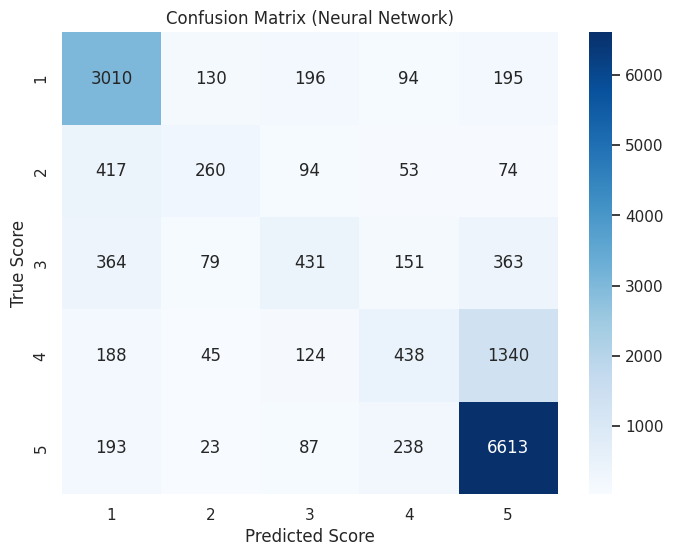

In [47]:
# Evaluate the model on the test set
loss, accuracy = model.evaluate(X_test_nn, y_test_nn, verbose=0)

print(f"Test Accuracy: {accuracy:.4f}")
print(f"Test Loss: {loss:.4f}")

# Further evaluation with classification report and confusion matrix
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Get predictions as class indices
y_pred_nn = model.predict(X_test_nn)
y_pred_classes = np.argmax(y_pred_nn, axis=1)
y_true_classes = np.argmax(y_test_nn, axis=1)

# Print classification report
# Adjust target names back to original scores (1-5)
target_names = [str(i+1) for i in range(5)]
print("\nClassification Report:")
print(classification_report(y_true_classes, y_pred_classes, target_names=target_names))

# Plot confusion matrix
cm_nn = confusion_matrix(y_true_classes, y_pred_classes)

plt.figure(figsize=(8, 6))
sns.heatmap(cm_nn, annot=True, fmt='d', cmap='Blues', xticklabels=target_names, yticklabels=target_names)
plt.title('Confusion Matrix (Neural Network)')
plt.xlabel('Predicted Score')
plt.ylabel('True Score')
plt.show()

#### 5.2.2 Ajustes de Hiperparametros

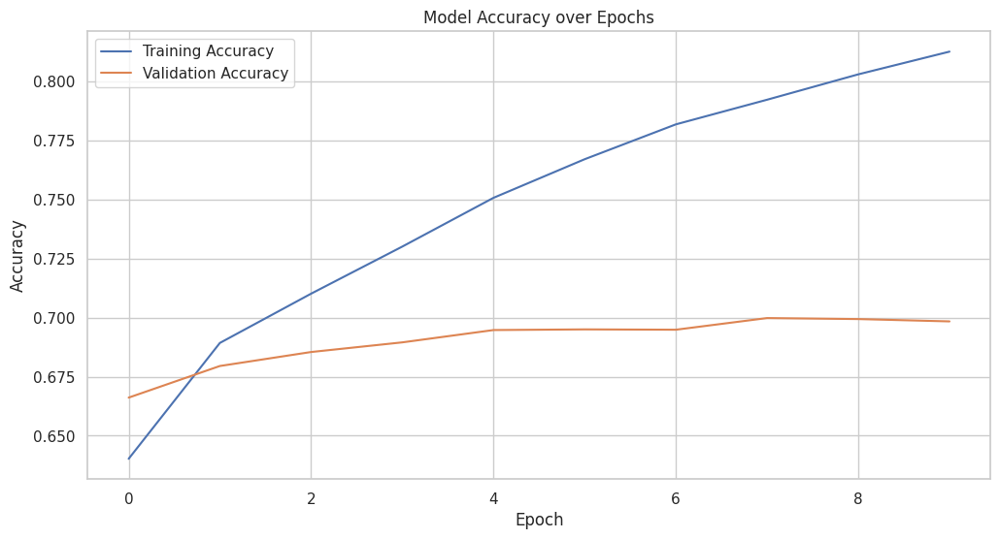

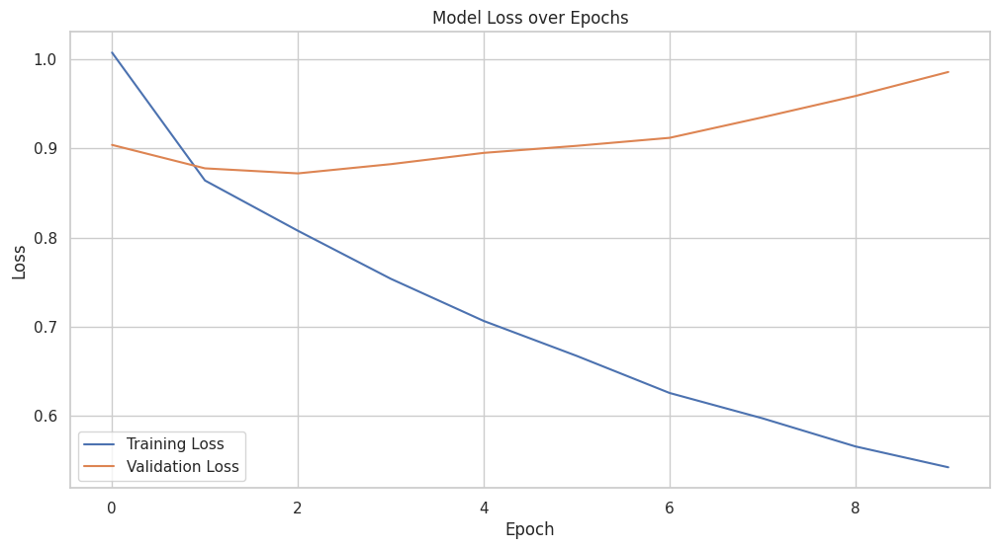

In [ ]:
import matplotlib.pyplot as plt

# Plot training and validation accuracy
plt.figure(figsize=(12, 6))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

# Plot training and validation loss
plt.figure(figsize=(12, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

La brecha entre ambas curvas en ambos graficos, después del Epoch 2, sugiere overfitting. Notar que:

* En curva de Epoch Vs Accuracy, a partir de ese valor la brecha comienza a crecer.  Ademas, la curva de validacion comienza a presentar un crecimiento practicamente nulo.

* En curva de Epoch Vs Loss, a partir de ese valor no solo comienza a aumentar la brecha, sino que ademas la curva de validacion deja de decrecer.

El modelo aprende bien los datos de entrenamiento por su accuracy relativamente alto o aceptable con el valor propuesto.

In [48]:
!pip install keras-tuner

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 4.6 MB/s eta 0:00:00


In [49]:
import keras_tuner as kt
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential

# Define the hypermodel function
def build_model(hp):
    model = Sequential()
    model.add(Dense(units=hp.Int('dense_1_units', min_value=32, max_value=512, step=32),
                    input_shape=(X_train_nn.shape[1],),
                    activation='relu'))
    model.add(Dropout(hp.Float('dropout_1', min_value=0.0, max_value=0.5, step=0.1)))

    # Add a second dense layer with a probability of 0.5
    if hp.Boolean("add_dense_2"):
        model.add(Dense(units=hp.Int('dense_2_units', min_value=32, max_value=256, step=32),
                        activation='relu'))
        model.add(Dropout(hp.Float('dropout_2', min_value=0.0, max_value=0.5, step=0.1)))


    model.add(Dense(5, activation='softmax')) # 5 output units for 5 classes (scores 1-5)

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return model

# Instantiate the tuner
tuner = kt.Hyperband(build_model,
                     objective='val_accuracy',
                     max_epochs=10,
                     factor=3,
                     directory='my_dir', # Directory to save the search results
                     project_name='intro_to_kt')

# Print a summary of the search space
tuner.search_space_summary()

Reloading Tuner from my_dir/intro_to_kt/tuner0.json
Search space summary
Default search space size: 6
dense_1_units (Int)
{'default': None, 'conditions': [], 'min_value': 32, 'max_value': 512, 'step': 32, 'sampling': 'linear'}
dropout_1 (Float)
{'default': 0.0, 'conditions': [], 'min_value': 0.0, 'max_value': 0.5, 'step': 0.1, 'sampling': 'linear'}
add_dense_2 (Boolean)
{'default': False, 'conditions': []}
learning_rate (Choice)
{'default': 0.01, 'conditions': [], 'values': [0.01, 0.001, 0.0001], 'ordered': True}
dense_2_units (Int)
{'default': None, 'conditions': [], 'min_value': 32, 'max_value': 256, 'step': 32, 'sampling': 'linear'}
dropout_2 (Float)
{'default': 0.0, 'conditions': [], 'min_value': 0.0, 'max_value': 0.5, 'step': 0.1, 'sampling': 'linear'}


In [55]:
# Run the hyperparameter search
# Limiting epochs to 2 for faster execution
tuner.search(X_train_nn, y_train_nn, epochs=2, validation_split=0.2) # Reduced epochs

# Get the best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

print(f"""
The optimal number of units in the first dense layer is {best_hps.get('dense_1_units')}.
The optimal dropout rate for the first layer is {best_hps.get('dropout_1')}.
Whether a second dense layer was added: {best_hps.get('add_dense_2')}.
If added, the optimal number of units in the second dense layer is {best_hps.get('dense_2_units')}.
If added, the optimal dropout rate for the second layer is {best_hps.get('dropout_2')}.
The optimal learning rate for the optimizer is {best_hps.get('learning_rate')}.
""")

# Get the best model
best_model_tuned_nn = tuner.get_best_models(num_models=1)[0]

# Summarize the best model
best_model_tuned_nn.summary()

Trial 27 Complete [00h 06m 26s]
val_accuracy: 0.7001268863677979

Best val_accuracy So Far: 0.706753134727478
Total elapsed time: 02h 14m 29s

The optimal number of units in the first dense layer is 256.
The optimal dropout rate for the first layer is 0.2.
Whether a second dense layer was added: True.
If added, the optimal number of units in the second dense layer is 96.
If added, the optimal dropout rate for the second layer is 0.0.
The optimal learning rate for the optimizer is 0.001.



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 256)            │     1,280,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 96)             │        24,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 96)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 5)              │           485 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,305,413 (4.98 MB)

 Trainable params: 1,305,413 (4.98 MB)

 Non-trainable params: 0 (0.00 B)

475/475 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step


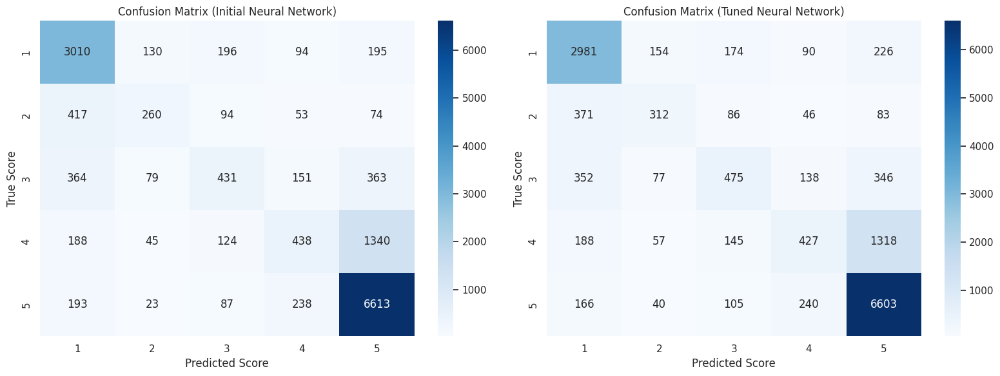


Classification Report (Tuned Neural Network):
              precision    recall  f1-score   support

           1       0.73      0.82      0.78      3625
           2       0.49      0.35      0.41       898
           3       0.48      0.34      0.40      1388
           4       0.45      0.20      0.28      2135
           5       0.77      0.92      0.84      7154

    accuracy                           0.71     15200
   macro avg       0.59      0.53      0.54     15200
weighted avg       0.67      0.71      0.68     15200



In [57]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Get predictions from the best tuned model
y_pred_tuned_nn = best_model_tuned_nn.predict(X_test_nn)

# Convert predictions and true labels from one-hot encoding to class indices
y_pred_tuned_classes = np.argmax(y_pred_tuned_nn, axis=1)
y_true_classes_nn = np.argmax(y_test_nn, axis=1)

# Calculate the confusion matrix for the tuned model
cm_tuned_nn = confusion_matrix(y_true_classes_nn, y_pred_tuned_classes)

# Assuming cm_nn from the initial model evaluation is available
# If not, you might need to re-run the evaluation of the initial model

# Get the target names (original scores 1-5)
target_names_nn = [str(i+1) for i in range(5)]

# Create subplots for the two confusion matrices side-by-side
fig, axes = plt.subplots(1, 2, figsize=(16, 6)) # Adjust figure size as needed

# Plot the confusion matrix for the initial model
sns.heatmap(cm_nn, annot=True, fmt='d', cmap='Blues', xticklabels=target_names_nn, yticklabels=target_names_nn, ax=axes[0])
axes[0].set_title('Confusion Matrix (Initial Neural Network)')
axes[0].set_xlabel('Predicted Score')
axes[0].set_ylabel('True Score')

# Plot the confusion matrix for the tuned model
sns.heatmap(cm_tuned_nn, annot=True, fmt='d', cmap='Blues', xticklabels=target_names_nn, yticklabels=target_names_nn, ax=axes[1])
axes[1].set_title('Confusion Matrix (Tuned Neural Network)')
axes[1].set_xlabel('Predicted Score')
axes[1].set_ylabel('True Score')

plt.tight_layout()
plt.show()

# Print classification report for the tuned model
print("\nClassification Report (Tuned Neural Network):")
print(classification_report(y_true_classes_nn, y_pred_tuned_classes, target_names=target_names_nn))

Se evidencia que no existen practicamente mejorias luego de los ajustes de parametros propuestos. Si bien predice mejor los valores intermedios (2 y 3), existe una leve desmejoria en los restantes (1, 4 y 5).

## 6. CONCLUSIONES E INSIGHTS FINALES

El analisis realizado permitio inferir correctamente la percepcion del nivel de servicio ofrecido por la plataforma de e-commerce a traves de sus reseñas. A partir del preprocesamiento del texto, técnicas de análisis exploratorio, entrenamiento de modelos de machine learning y el entrenamiento de una red neuronal simple, se identificaron patrones y comportamientos de valor para los vendedores, usuarios y propietarios de la plataforma de comercio electronico, brindando una potente herramienta para potenciar los puntos positivos y mejorar aquellos que sean necesarios.

Las reseñas positivas tienen con mayor frecuencia palabras ligadas a producto, plazo, entrega, entre otros.

Por el contrario, las negativas tienen con mayor frecuencia las palabras ligadas a producto, recepcion, compra y entrega.

Es interesante luego ver como estas se diferencian al evaluar bigrams y trigrams (si bien la palabra producto es la de mayor frecuencia en ambos unigrams, en el caso positivo aparece mas ligado con la entrega, mientras que en el caso negativo aparece mas asociado con la palabra recepcion).

En promedio, los comentarios negativos tienen una longitud que practicamente dobla a los comentarios positivos. Del mismo modo, los comentarios neutros tienen una longitud promedio mayor a los positivos. Esto es habitual y razonable, ya que cuando un comentario no es bueno suele requerir de mayor explicacion o cantidad de palabras para poder argumentarlo debidamente.

Todos los modelos de machine learning tuvieron un comportamiento aceptable en la prediccion de tipos de comentarios, siendo estos mucho mas acertivos para positivos, luego para negativos y con peor performance para predecir aquellos neutros (esto es natural por el balance de clases).

Si bien se exploraron tecnicas de ajuste de hiperparametros para cada tecnica propuesta, tambien podriamos haber empleado tecnicas de balance de clases. De todas formas, por el valor aceptable se propone no profundizar en ello (se deja aclarado como una posibilidad).

Del mismo modo, se evidencio un buen comportamiento del modelo de redes neuronales simples para la prediccion en este caso de los score o calificacion realizada por los usuarios. Aqui si podria ser mas necesario aplicar metodologias de balance de clases, pero para ello debiera especificarse mejor el objetivo del analisis (ej: si quisiera evaluar con mas detalle las malas calificaciones, deberiamos potenciar los valores bajos).